In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import plotly.express as px
from pylab import rcParams
import warnings
import seaborn as sns 
from math import pi

rcParams["figure.figsize"]=(30,18)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 15
warnings.filterwarnings("ignore")
warnings.simplefilter(action='ignore', category=FutureWarning)
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/maternal-health-risk-data/Maternal Health Risk Data Set.csv


In [2]:
data =pd.read_csv("/kaggle/input/maternal-health-risk-data/Maternal Health Risk Data Set.csv")
data

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
0,25,130,80,15.0,98.0,86,high risk
1,35,140,90,13.0,98.0,70,high risk
2,29,90,70,8.0,100.0,80,high risk
3,30,140,85,7.0,98.0,70,high risk
4,35,120,60,6.1,98.0,76,low risk
...,...,...,...,...,...,...,...
1009,22,120,60,15.0,98.0,80,high risk
1010,55,120,90,18.0,98.0,60,high risk
1011,35,85,60,19.0,98.0,86,high risk
1012,43,120,90,18.0,98.0,70,high risk


In [3]:
df=data.copy()

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1014 entries, 0 to 1013
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Age          1014 non-null   int64  
 1   SystolicBP   1014 non-null   int64  
 2   DiastolicBP  1014 non-null   int64  
 3   BS           1014 non-null   float64
 4   BodyTemp     1014 non-null   float64
 5   HeartRate    1014 non-null   int64  
 6   RiskLevel    1014 non-null   object 
dtypes: float64(2), int64(4), object(1)
memory usage: 55.6+ KB


In [5]:
data.isnull().sum()

Age            0
SystolicBP     0
DiastolicBP    0
BS             0
BodyTemp       0
HeartRate      0
RiskLevel      0
dtype: int64

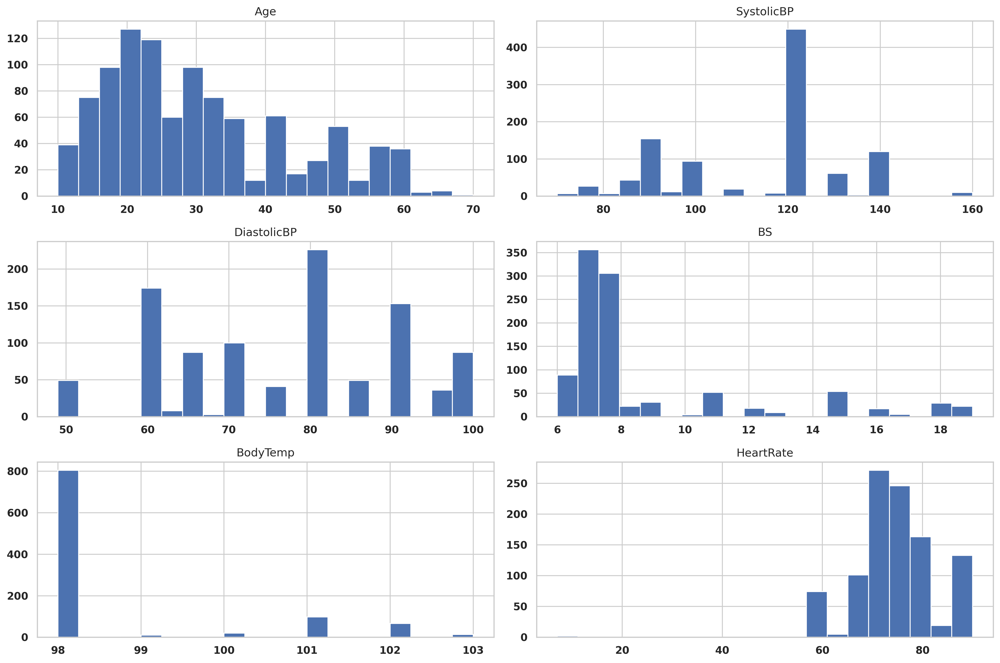

In [6]:
sns.set(style = "whitegrid")
data.hist(bins=20 , figsize=(15,10))
plt.tight_layout()
plt.show()

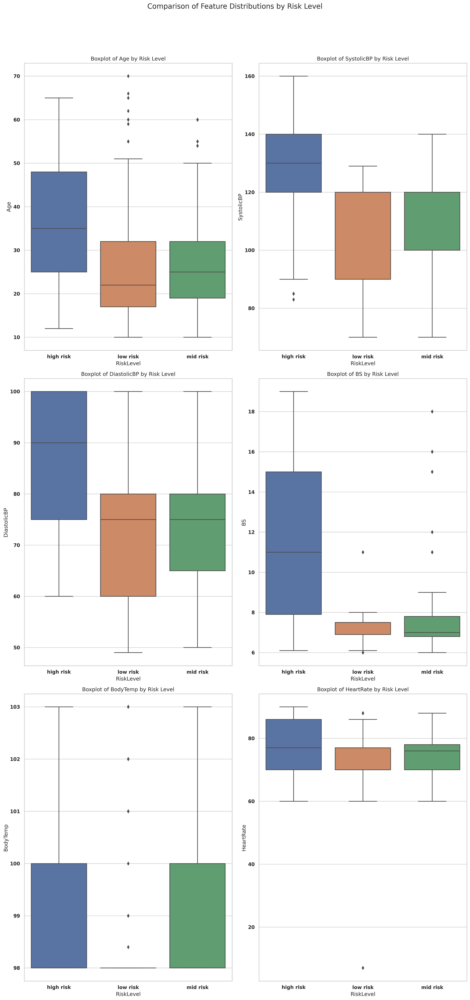

In [7]:

numeric_cols = data.select_dtypes(include=['number']).columns

num_cols = len(numeric_cols)

fig, axes = plt.subplots(nrows=(num_cols + 1) // 2, ncols=2, figsize=(15, 10 * ((num_cols + 1) // 2)))
axes = axes.flatten()  
for i, col in enumerate(numeric_cols):
    sns.boxplot(x='RiskLevel', y=col, data=data, ax=axes[i])
    axes[i].set_title(f'Boxplot of {col} by Risk Level')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()  
plt.suptitle('Comparison of Feature Distributions by Risk Level', fontsize=16, y=1.05)
plt.show()


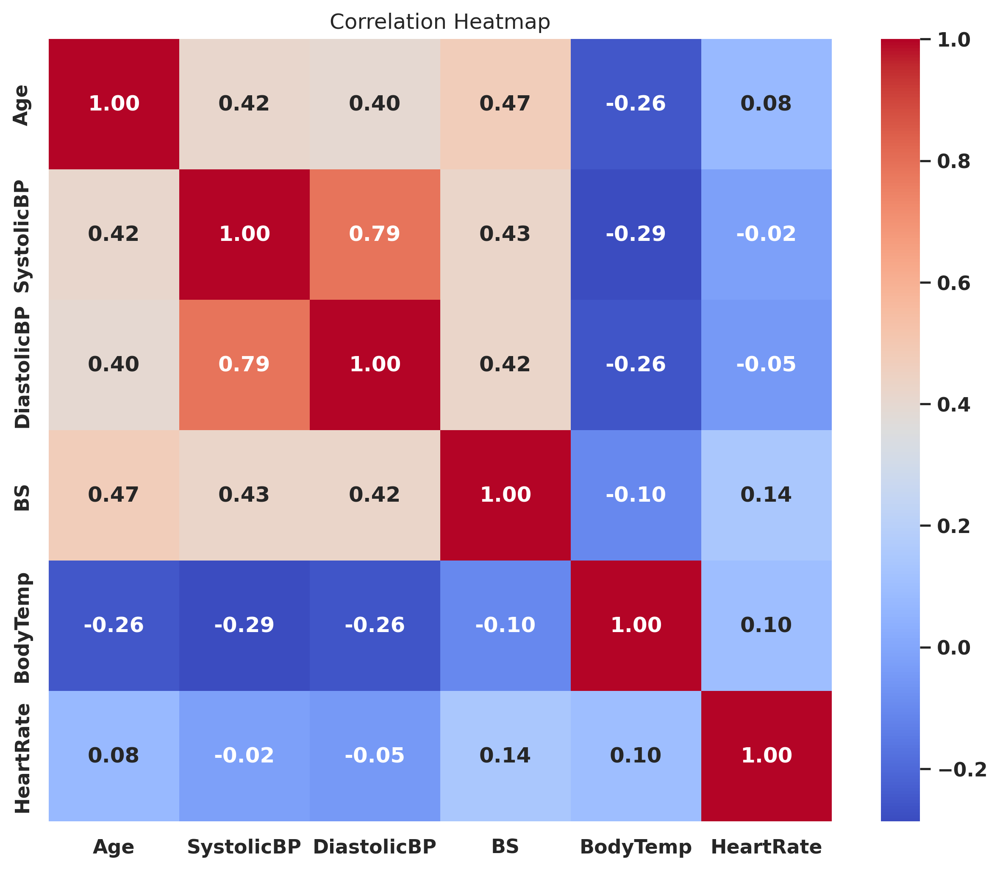

In [8]:
plt.figure(figsize=(10, 8))
correlation = data[numeric_cols].corr()
sns.heatmap(correlation, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Correlation Heatmap')
plt.show()


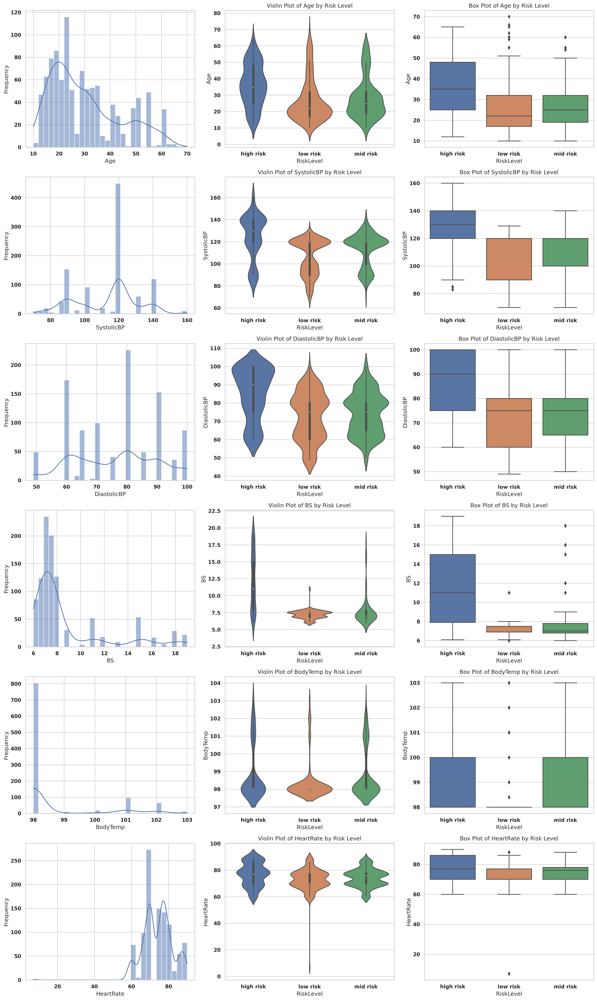

In [9]:
num_cols = len(numeric_cols)
fig, axes = plt.subplots(nrows=num_cols, ncols=3, figsize=(18, num_cols * 5))

for i, col in enumerate(numeric_cols):
    sns.histplot(data[col], bins=30, kde=True, ax=axes[i, 0])
    axes[i, 0].set_xlabel(col)
    axes[i, 0].set_ylabel('Frequency')

    sns.violinplot(x='RiskLevel', y=col, data=data, ax=axes[i, 1])
    axes[i, 1].set_title(f'Violin Plot of {col} by Risk Level')

    sns.boxplot(x='RiskLevel', y=col, data=data, ax=axes[i, 2])
    axes[i, 2].set_title(f'Box Plot of {col} by Risk Level')

plt.tight_layout()
plt.show()

In [10]:
sns.set(style='whitegrid', palette='muted')

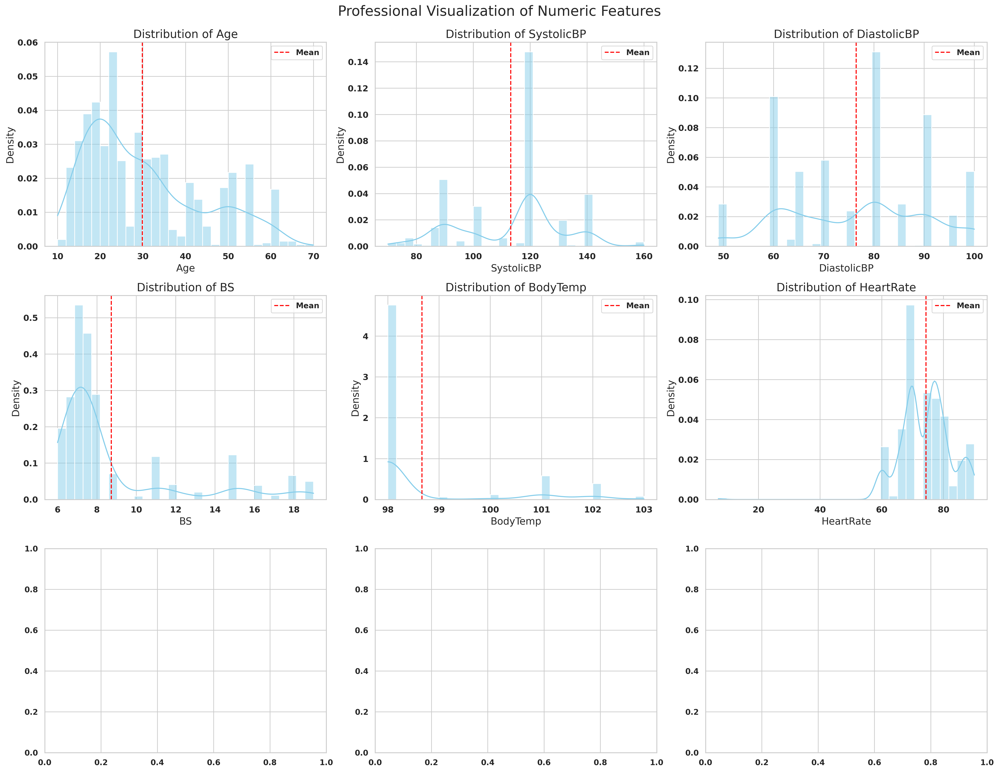

In [11]:
ig, axes = plt.subplots(nrows=(len(numeric_cols) + 1) // 2, ncols=3, figsize=(20, (len(numeric_cols) + 1) // 2 * 5))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(data[col], bins=30, kde=True, ax=axes[i], color='skyblue', stat='density')
    axes[i].set_title(f'Distribution of {col}', fontsize=16)
    axes[i].set_xlabel(col, fontsize=14)
    axes[i].set_ylabel('Density', fontsize=14)
    axes[i].tick_params(axis='both', which='major', labelsize=12)

    mean_value = data[col].mean()
    axes[i].axvline(mean_value, color='red', linestyle='--', label='Mean')
    axes[i].legend()

plt.tight_layout()
plt.suptitle('Professional Visualization of Numeric Features', fontsize=20, y=1.02)
plt.show()


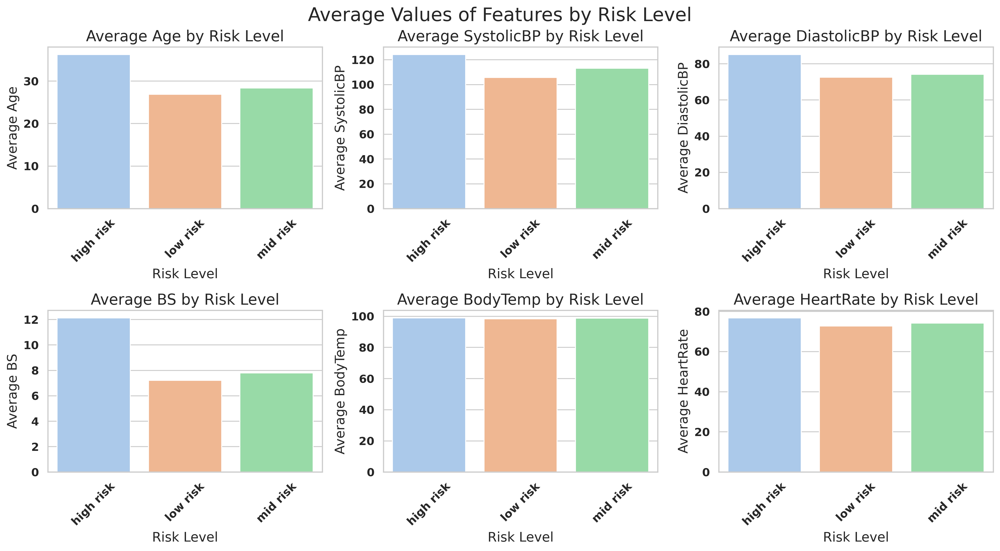

In [12]:
plt.figure(figsize=(15, 8))
for col in numeric_cols:
    plt.subplot(2, 3, numeric_cols.get_loc(col) + 1)  
    sns.barplot(x='RiskLevel', y=col, data=data, ci=None, palette='pastel')
    plt.title(f'Average {col} by Risk Level', fontsize=16)
    plt.ylabel(f'Average {col}', fontsize=14)
    plt.xlabel('Risk Level', fontsize=14)
    plt.xticks(rotation=45)
    plt.tick_params(axis='both', which='major', labelsize=12)

plt.tight_layout()
plt.suptitle('Average Values of Features by Risk Level', fontsize=20, y=1.02)
plt.show()

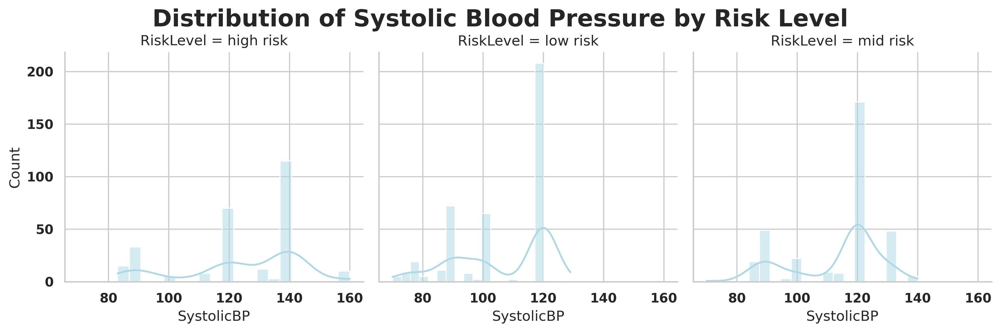

In [13]:
g = sns.FacetGrid(data, col="RiskLevel", height=4, aspect=1)
g.map(sns.histplot, 'SystolicBP', bins=20, kde=True, color='lightblue')
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribution of Systolic Blood Pressure by Risk Level', fontsize=20, fontweight='bold')
plt.show()

In [14]:
numeric_cols = data.select_dtypes(include=['int64', 'float64']).columns.tolist()
from scipy import stats  # Ensure this is included


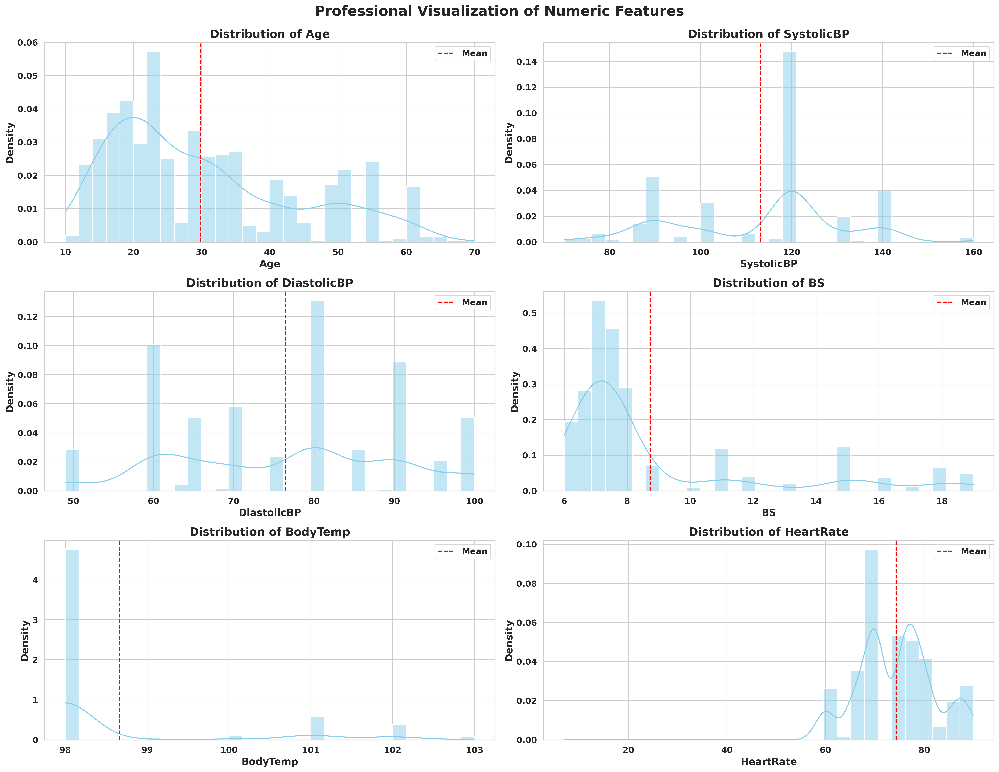

T-test results for SystolicBP between high and low risk:
T-statistic: 13.17, P-value: 0.0000


In [15]:
fig, axes = plt.subplots(nrows=(len(numeric_cols) + 1) // 2, ncols=2, figsize=(20, (len(numeric_cols) + 1) // 2 * 5))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    sns.histplot(data[col], bins=30, kde=True, ax=axes[i], color='skyblue', stat='density')
    axes[i].set_title(f'Distribution of {col}', fontsize=16, fontweight='bold')
    axes[i].set_xlabel(col, fontsize=14, fontweight='bold')
    axes[i].set_ylabel('Density', fontsize=14, fontweight='bold')
    axes[i].tick_params(axis='both', which='major', labelsize=12)

    mean_value = data[col].mean()
    axes[i].axvline(mean_value, color='red', linestyle='--', label='Mean')
    axes[i].legend(fontsize=12, loc='upper right', frameon=True)

plt.tight_layout()
plt.suptitle('Professional Visualization of Numeric Features', fontsize=20, fontweight='bold', y=1.02)
plt.show()

high_risk_bp = data[data['RiskLevel'] == 'high risk']['SystolicBP']
low_risk_bp = data[data['RiskLevel'] == 'low risk']['SystolicBP']

t_stat, p_value = stats.ttest_ind(high_risk_bp, low_risk_bp, nan_policy='omit')
print(f'T-test results for SystolicBP between high and low risk:\nT-statistic: {t_stat:.2f}, P-value: {p_value:.4f}')


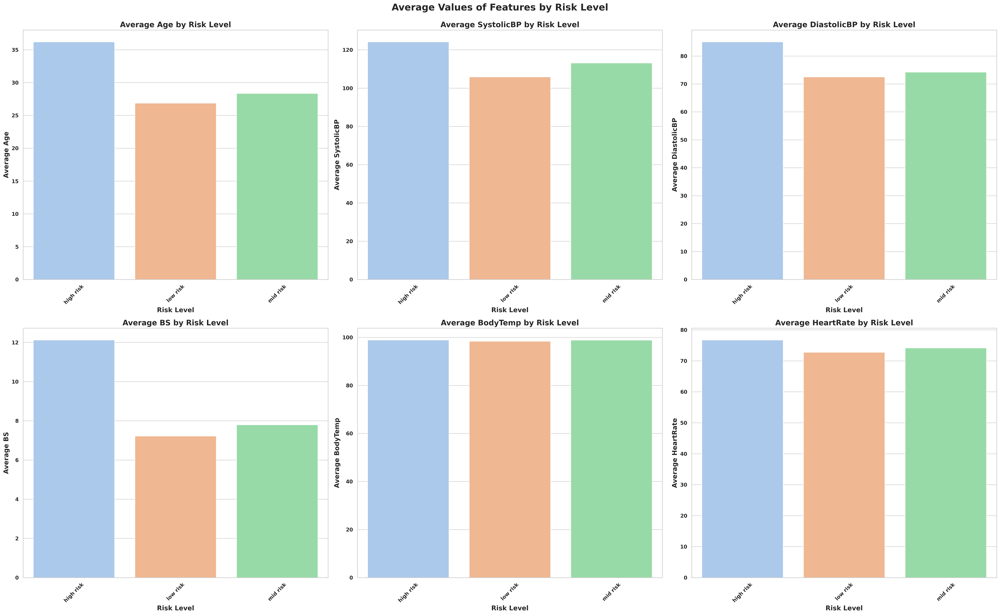

In [16]:
for col in numeric_cols:
    plt.subplot(2, 3, numeric_cols.index(col) + 1)  # Adjusting subplot index
    sns.barplot(x='RiskLevel', y=col, data=data, ci=None, palette='pastel')
    plt.title(f'Average {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.ylabel(f'Average {col}', fontsize=14, fontweight='bold')
    plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
    plt.xticks(rotation=45, fontweight='bold')

# Adjust layout
plt.tight_layout()
plt.suptitle('Average Values of Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()

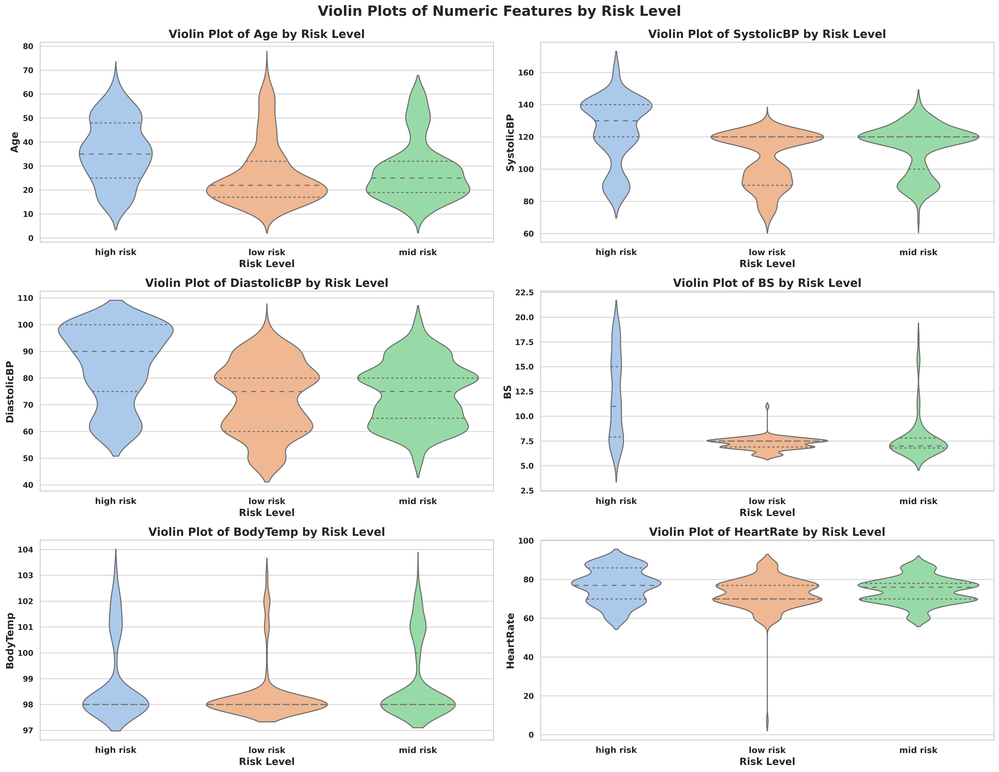

In [17]:
plt.figure(figsize=(20, 15))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i + 1)
    sns.violinplot(x='RiskLevel', y=col, data=data, inner='quartile', palette='pastel')
    plt.title(f'Violin Plot of {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
    plt.ylabel(col, fontsize=14, fontweight='bold')
    plt.xticks(fontsize=12)

plt.tight_layout()
plt.suptitle('Violin Plots of Numeric Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()



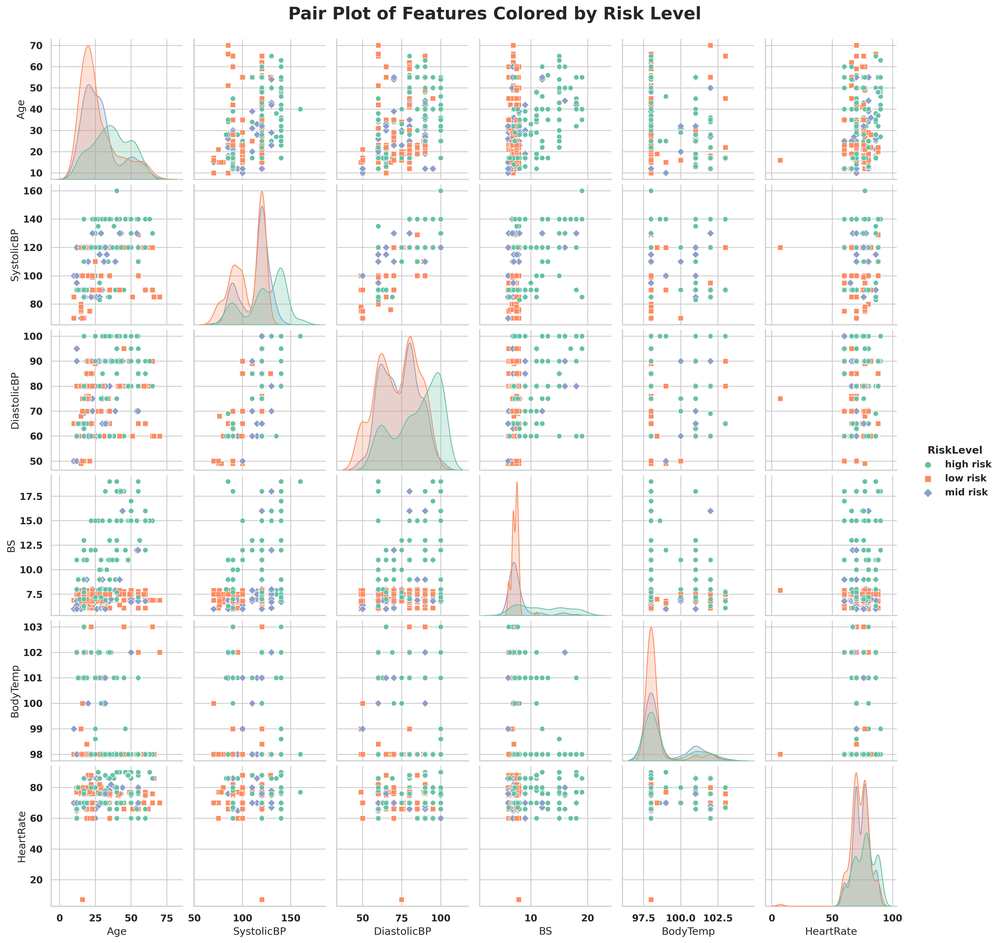

In [18]:
sns.pairplot(data, hue='RiskLevel', palette='Set2', diag_kind='kde', markers=['o', 's', 'D'])
plt.suptitle('Pair Plot of Features Colored by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()

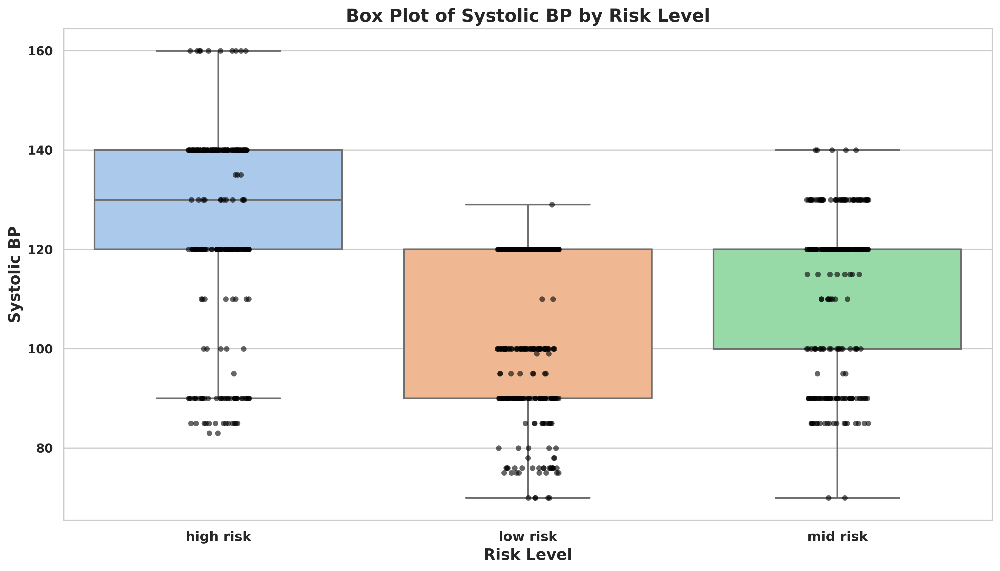

In [19]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='RiskLevel', y='SystolicBP', data=data, palette='pastel', showfliers=False)
sns.stripplot(x='RiskLevel', y='SystolicBP', data=data, color='black', alpha=0.6, jitter=True)
plt.title('Box Plot of Systolic BP by Risk Level', fontsize=16, fontweight='bold')
plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
plt.ylabel('Systolic BP', fontsize=14, fontweight='bold')
plt.xticks(fontsize=12)
plt.show()


In [20]:
grouped = data.groupby('RiskLevel')['SystolicBP'].describe()
print("Statistical Summary of Systolic BP by Risk Level:\n", grouped)


Statistical Summary of Systolic BP by Risk Level:
            count        mean        std   min    25%    50%    75%    max
RiskLevel                                                                
high risk  272.0  124.194853  20.227185  83.0  120.0  130.0  140.0  160.0
low risk   406.0  105.866995  15.894002  70.0   90.0  120.0  120.0  129.0
mid risk   336.0  113.154762  14.983170  70.0  100.0  120.0  120.0  140.0


In [21]:
grouped

,count,mean,std,min,25%,50%,75%,max
RiskLevel,,,,,,,,
high risk,272.0,124.194853,20.227185,83.0,120.0,130.0,140.0,160.0
low risk,406.0,105.866995,15.894002,70.0,90.0,120.0,120.0,129.0
mid risk,336.0,113.154762,14.983170,70.0,100.0,120.0,120.0,140.0


In [22]:
high_risk_bp = data[data['RiskLevel'] == 'high risk']['SystolicBP']
low_risk_bp = data[data['RiskLevel'] == 'low risk']['SystolicBP']

if not low_risk_bp.empty:
    t_stat, p_value = stats.ttest_ind(high_risk_bp, low_risk_bp, nan_policy='omit')
    print(f'T-test results for Systolic BP between high and low risk:\nT-statistic: {t_stat:.2f}, P-value: {p_value:.4f}')


T-test results for Systolic BP between high and low risk:
T-statistic: 13.17, P-value: 0.0000


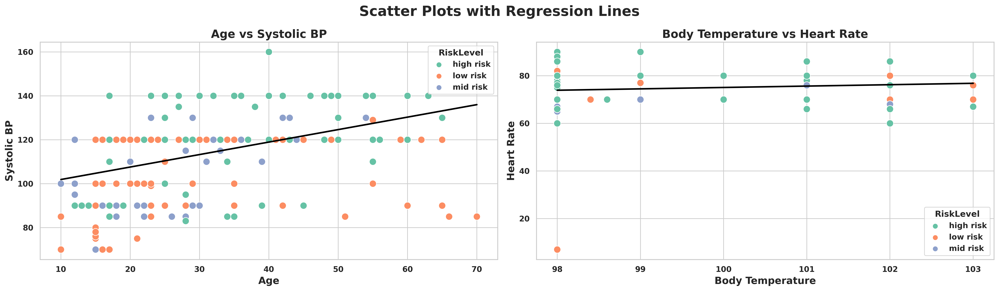

In [23]:
plt.figure(figsize=(20, 15))

plt.subplot(3, 2, 1)
sns.scatterplot(x='Age', y='SystolicBP', hue='RiskLevel', data=data, palette='Set2', s=100)
sns.regplot(x='Age', y='SystolicBP', data=data, scatter=False, color='black', ci=None)
plt.title('Age vs Systolic BP', fontsize=16, fontweight='bold')
plt.xlabel('Age', fontsize=14, fontweight='bold')
plt.ylabel('Systolic BP', fontsize=14, fontweight='bold')

plt.subplot(3, 2, 2)
sns.scatterplot(x='BodyTemp', y='HeartRate', hue='RiskLevel', data=data, palette='Set2', s=100)
sns.regplot(x='BodyTemp', y='HeartRate', data=data, scatter=False, color='black', ci=None)
plt.title('Body Temperature vs Heart Rate', fontsize=16, fontweight='bold')
plt.xlabel('Body Temperature', fontsize=14, fontweight='bold')
plt.ylabel('Heart Rate', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.suptitle('Scatter Plots with Regression Lines', fontsize=20, fontweight='bold', y=1.02)
plt.show()

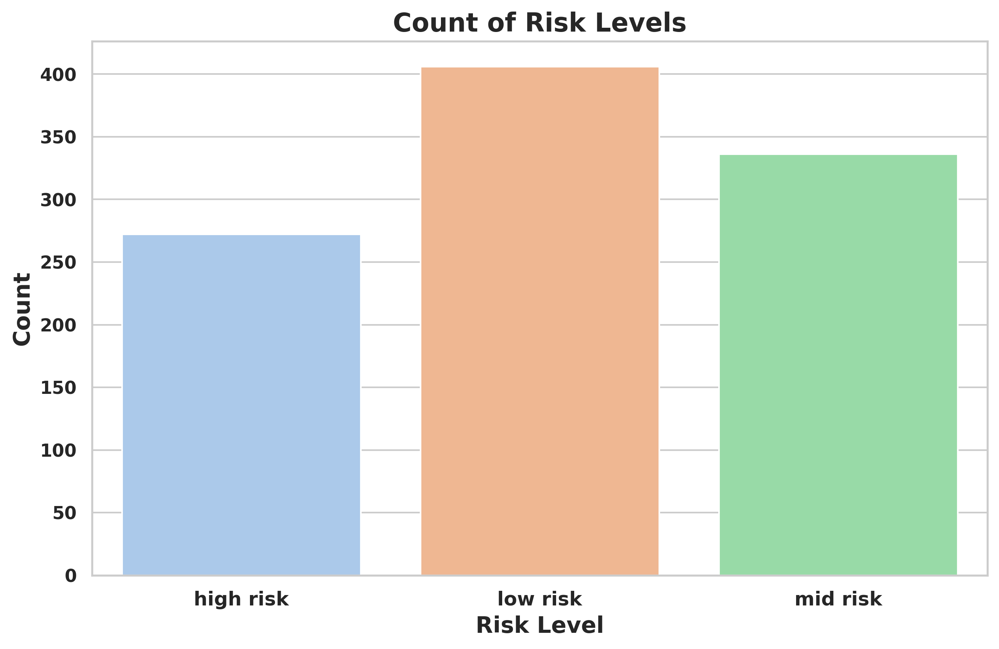

In [24]:
plt.figure(figsize=(10, 6))
sns.countplot(x='RiskLevel', data=data, palette='pastel')
plt.title('Count of Risk Levels', fontsize=16, fontweight='bold')
plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
plt.ylabel('Count', fontsize=14, fontweight='bold')
plt.xticks(fontsize=12)
plt.show()


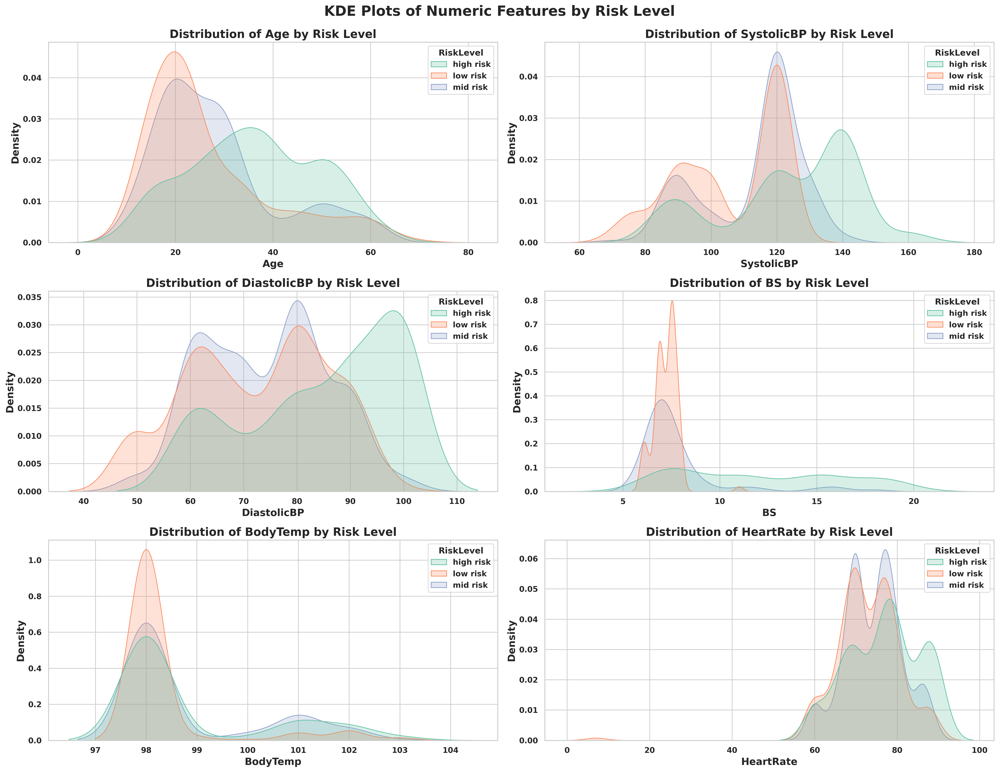

In [25]:
plt.figure(figsize=(20, 15))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i + 1)
    sns.kdeplot(data=data, x=col, hue='RiskLevel', common_norm=False, palette='Set2', fill=True)
    plt.title(f'Distribution of {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.xlabel(col, fontsize=14, fontweight='bold')
    plt.ylabel('Density', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.suptitle('KDE Plots of Numeric Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()


In [26]:
from scipy import stats

anova_result = stats.f_oneway(
    data[data['RiskLevel'] == 'high risk']['SystolicBP'],
    data[data['RiskLevel'] == 'mid risk']['SystolicBP'],
    data[data['RiskLevel'] == 'low risk']['SystolicBP']
)
print(f'ANOVA results for Systolic BP:\nF-statistic: {anova_result.statistic:.2f}, P-value: {anova_result.pvalue:.4f}')

kruskal_result = stats.kruskal(
    data[data['RiskLevel'] == 'high risk']['DiastolicBP'],
    data[data['RiskLevel'] == 'mid risk']['DiastolicBP'],
    data[data['RiskLevel'] == 'low risk']['DiastolicBP']
)
print(f'Kruskal-Wallis results for Diastolic BP:\nH-statistic: {kruskal_result.statistic:.2f}, P-value: {kruskal_result.pvalue:.4f}')


ANOVA results for Systolic BP:
F-statistic: 95.90, P-value: 0.0000
Kruskal-Wallis results for Diastolic BP:
H-statistic: 133.76, P-value: 0.0000


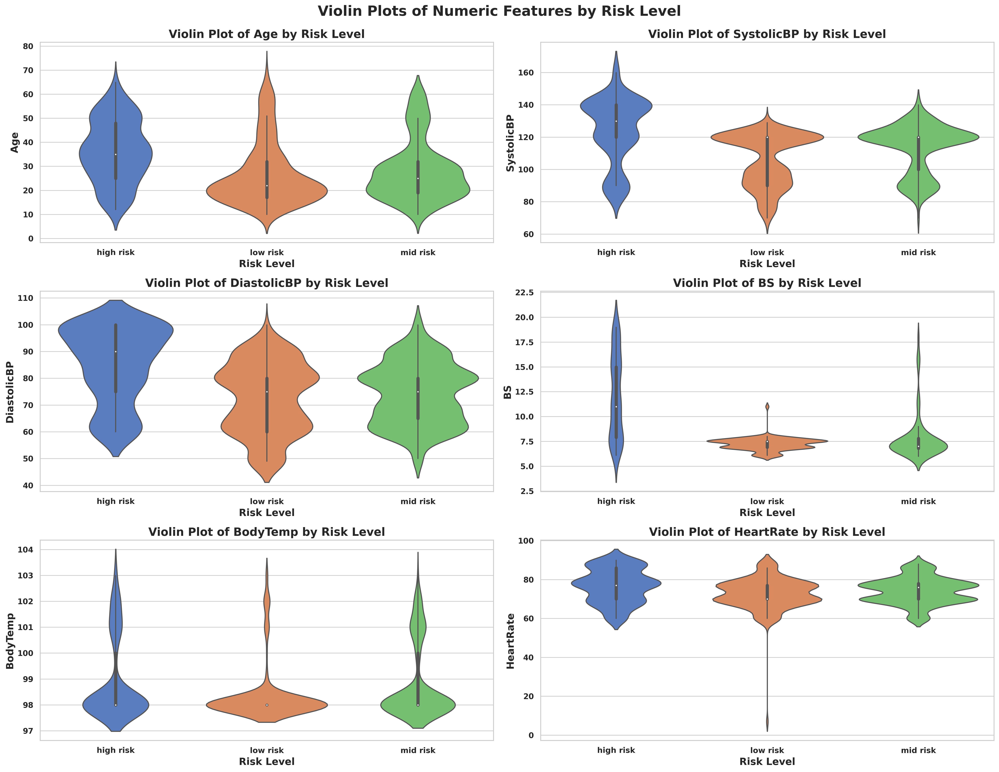

In [27]:
plt.figure(figsize=(20, 15))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i + 1)
    sns.violinplot(x='RiskLevel', y=col, data=data, palette='muted')
    plt.title(f'Violin Plot of {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
    plt.ylabel(col, fontsize=14, fontweight='bold')

plt.tight_layout()
plt.suptitle('Violin Plots of Numeric Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()


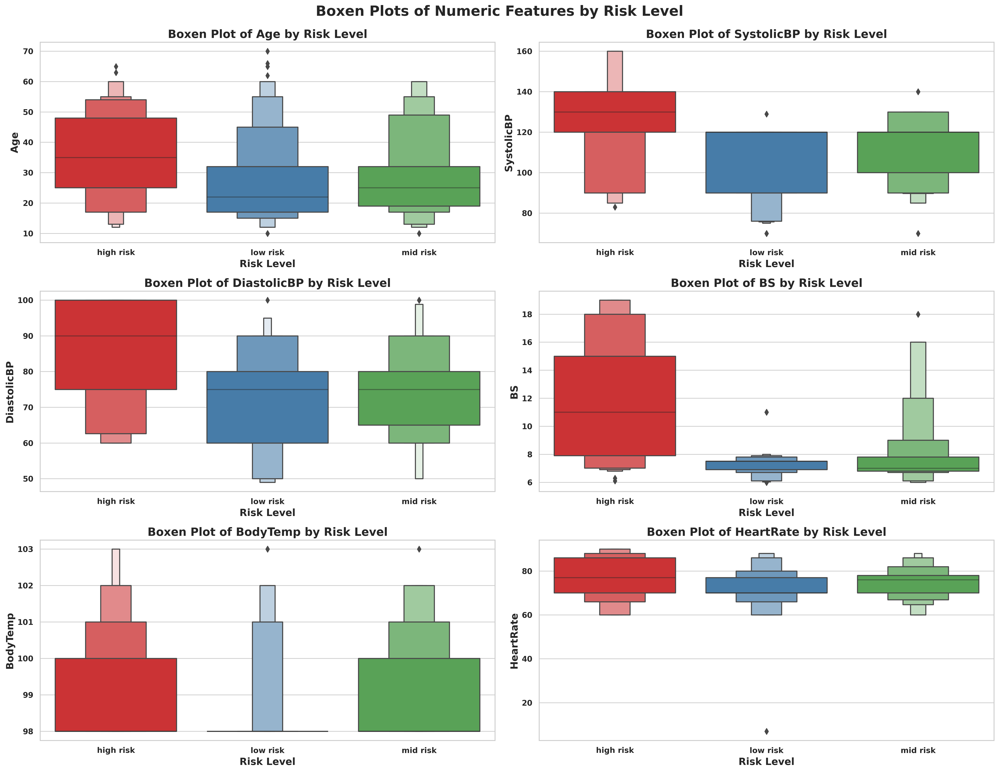

In [28]:
plt.figure(figsize=(20, 15))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i + 1)
    sns.boxenplot(x='RiskLevel', y=col, data=data, palette='Set1')
    plt.title(f'Boxen Plot of {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.xlabel('Risk Level', fontsize=14, fontweight='bold')
    plt.ylabel(col, fontsize=14, fontweight='bold')

plt.tight_layout()
plt.suptitle('Boxen Plots of Numeric Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()


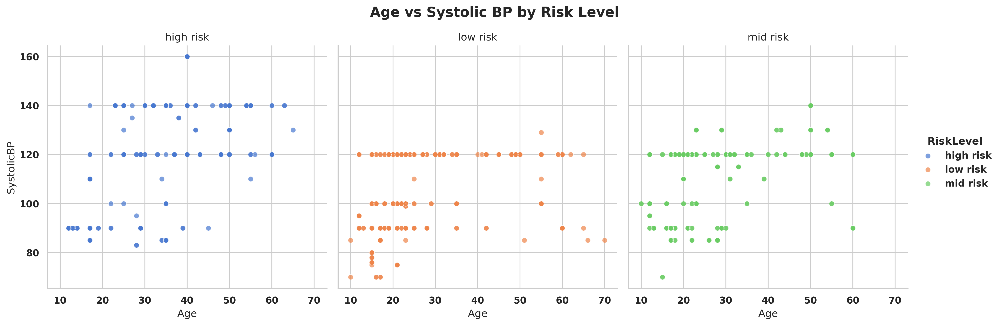

In [29]:
g = sns.FacetGrid(data, col='RiskLevel', hue='RiskLevel', height=5, aspect=1)
g.map(sns.scatterplot, 'Age', 'SystolicBP', alpha=0.7)
g.add_legend()
g.set_titles(col_template='{col_name}')
g.fig.suptitle('Age vs Systolic BP by Risk Level', fontsize=16, fontweight='bold', y=1.05)
plt.show()


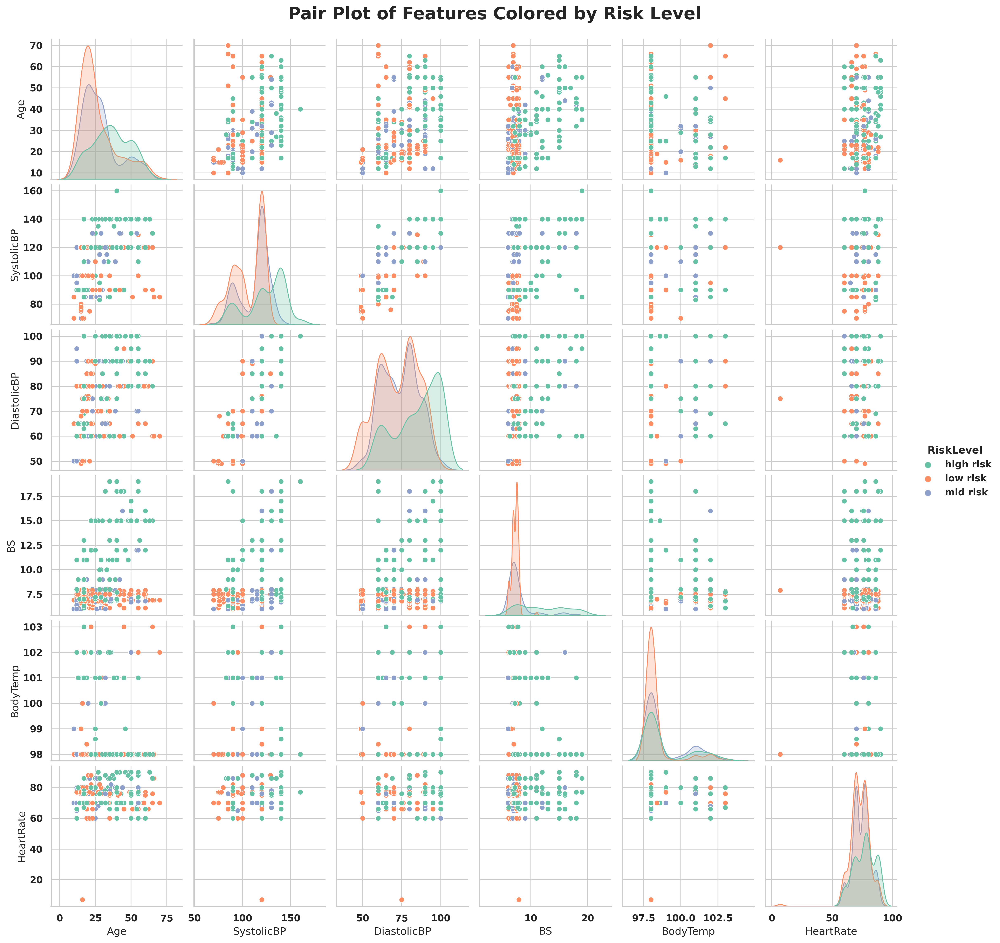

In [30]:
sns.pairplot(data, hue='RiskLevel', palette='Set2', diag_kind='kde')
plt.suptitle('Pair Plot of Features Colored by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()


In [31]:
import pandas as pd

# Create a summary DataFrame for statistical tests
test_summary = {
    'Test': ['ANOVA (SystolicBP)', 'Kruskal-Wallis (DiastolicBP)'],
    'Statistic': [anova_result.statistic, kruskal_result.statistic],
    'P-value': [anova_result.pvalue, kruskal_result.pvalue]
}

summary_df = pd.DataFrame(test_summary)
summary_df


,Test,Statistic,P-value
0,ANOVA (SystolicBP),95.902952,7.292194e-39
1,Kruskal-Wallis (DiastolicBP),133.757680,9.013406e-30


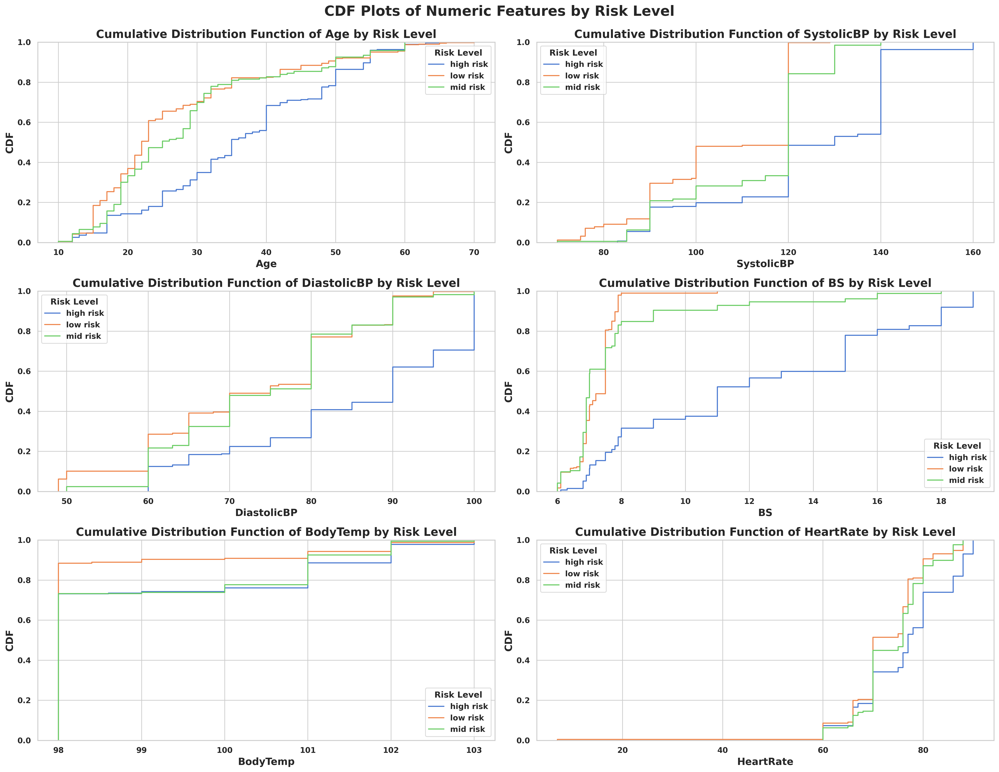

In [32]:
plt.figure(figsize=(20, 15))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i + 1)
    for risk_level in data['RiskLevel'].unique():
        sns.ecdfplot(data=data[data['RiskLevel'] == risk_level], x=col, label=risk_level)
    plt.title(f'Cumulative Distribution Function of {col} by Risk Level', fontsize=16, fontweight='bold')
    plt.xlabel(col, fontsize=14, fontweight='bold')
    plt.ylabel('CDF', fontsize=14, fontweight='bold')
    plt.legend(title='Risk Level')

plt.tight_layout()
plt.suptitle('CDF Plots of Numeric Features by Risk Level', fontsize=20, fontweight='bold', y=1.02)
plt.show()


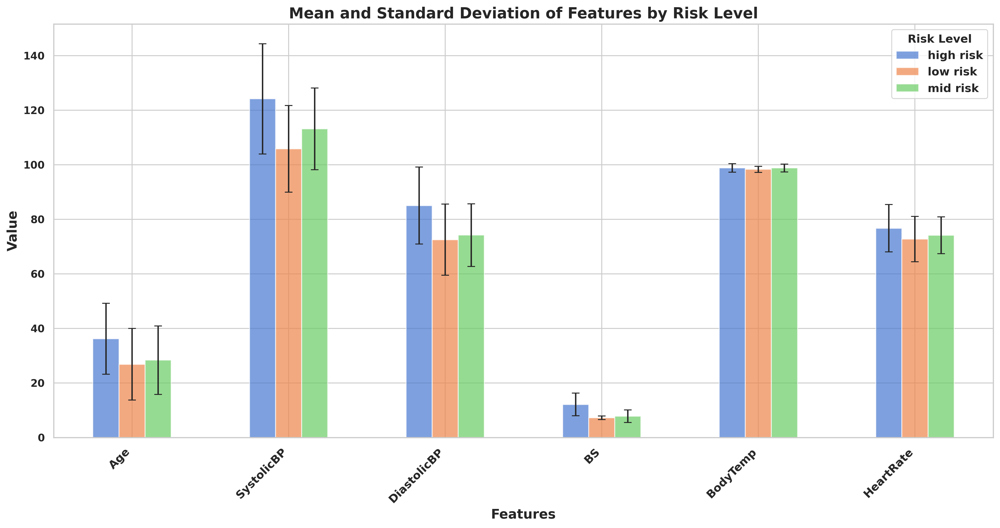

In [33]:
mean_values = data.groupby('RiskLevel').mean().T
std_values = data.groupby('RiskLevel').std().T

mean_values.plot(kind='bar', yerr=std_values, capsize=4, figsize=(15, 8), alpha=0.7)
plt.title('Mean and Standard Deviation of Features by Risk Level', fontsize=16, fontweight='bold')
plt.ylabel('Value', fontsize=14, fontweight='bold')
plt.xlabel('Features', fontsize=14, fontweight='bold')
plt.xticks(rotation=45, ha='right', fontsize=12, fontweight='bold')
plt.legend(title='Risk Level', fontsize=12)
plt.tight_layout()
plt.show()


<Figure size 3000x3000 with 0 Axes>

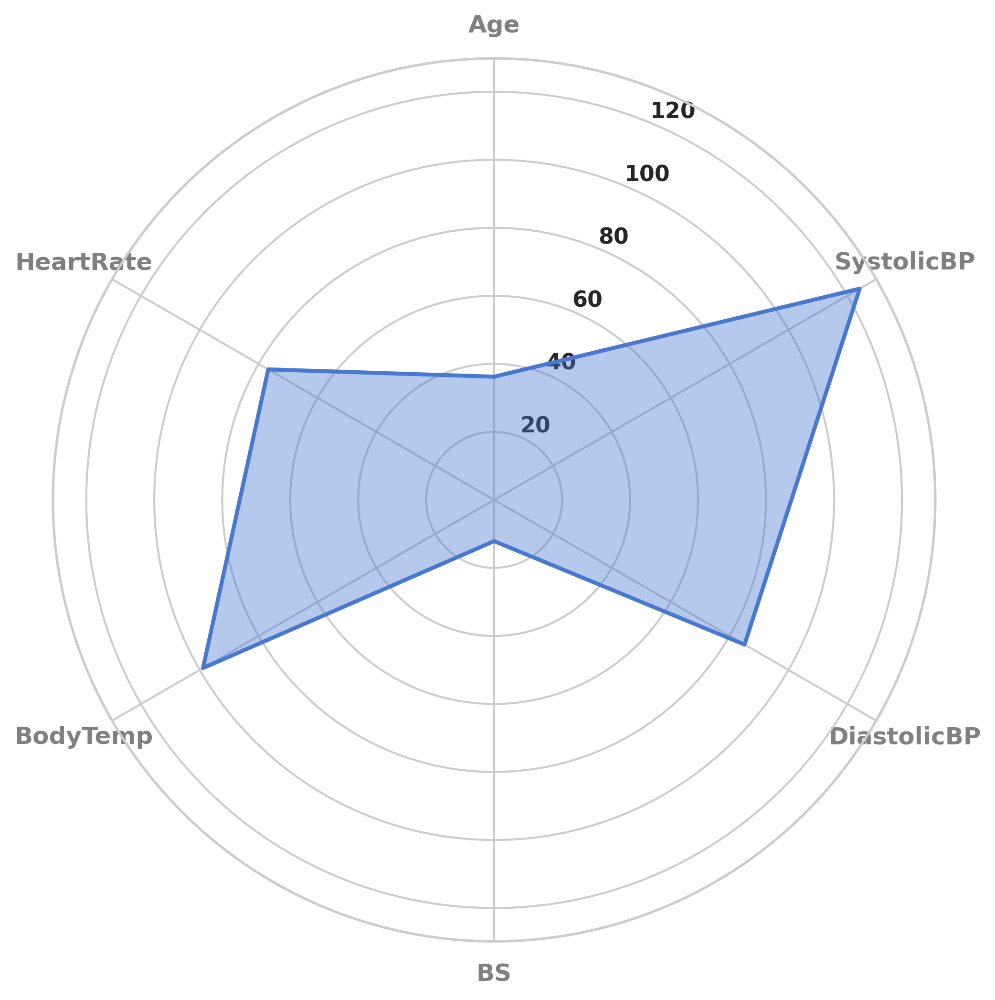

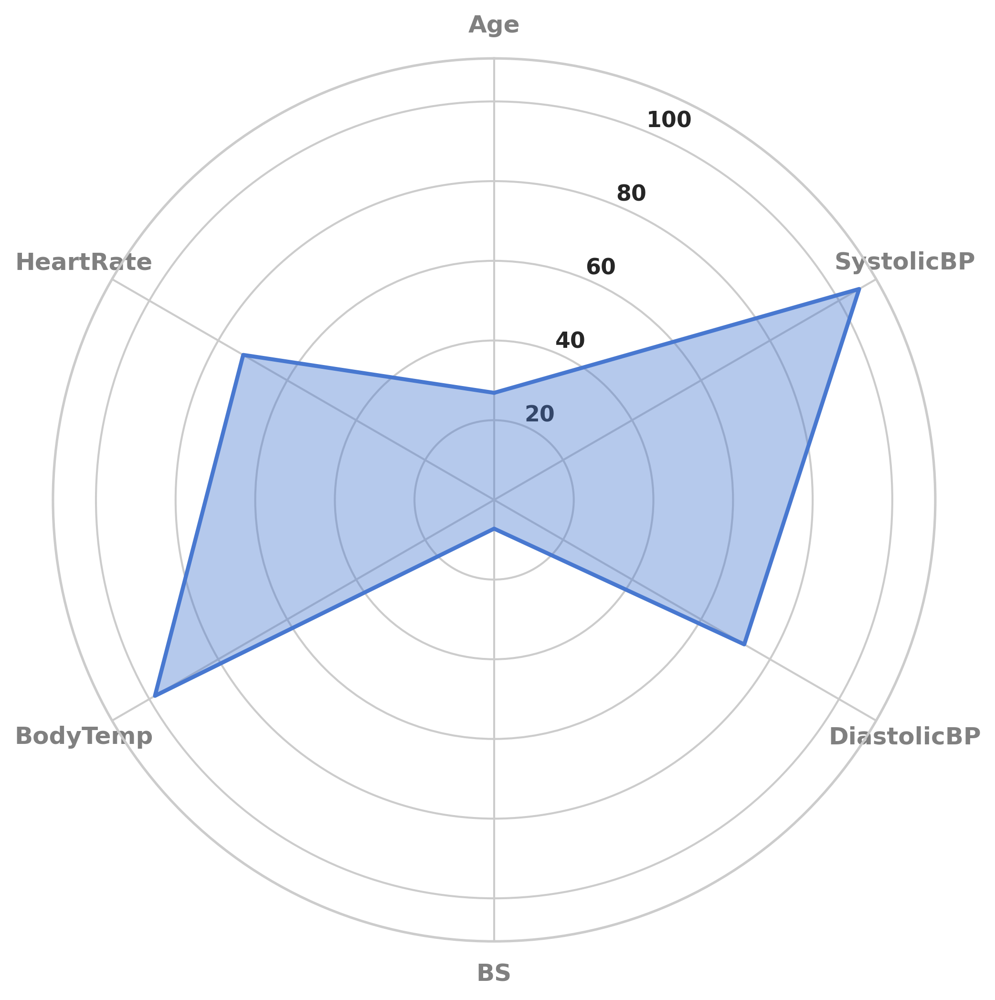

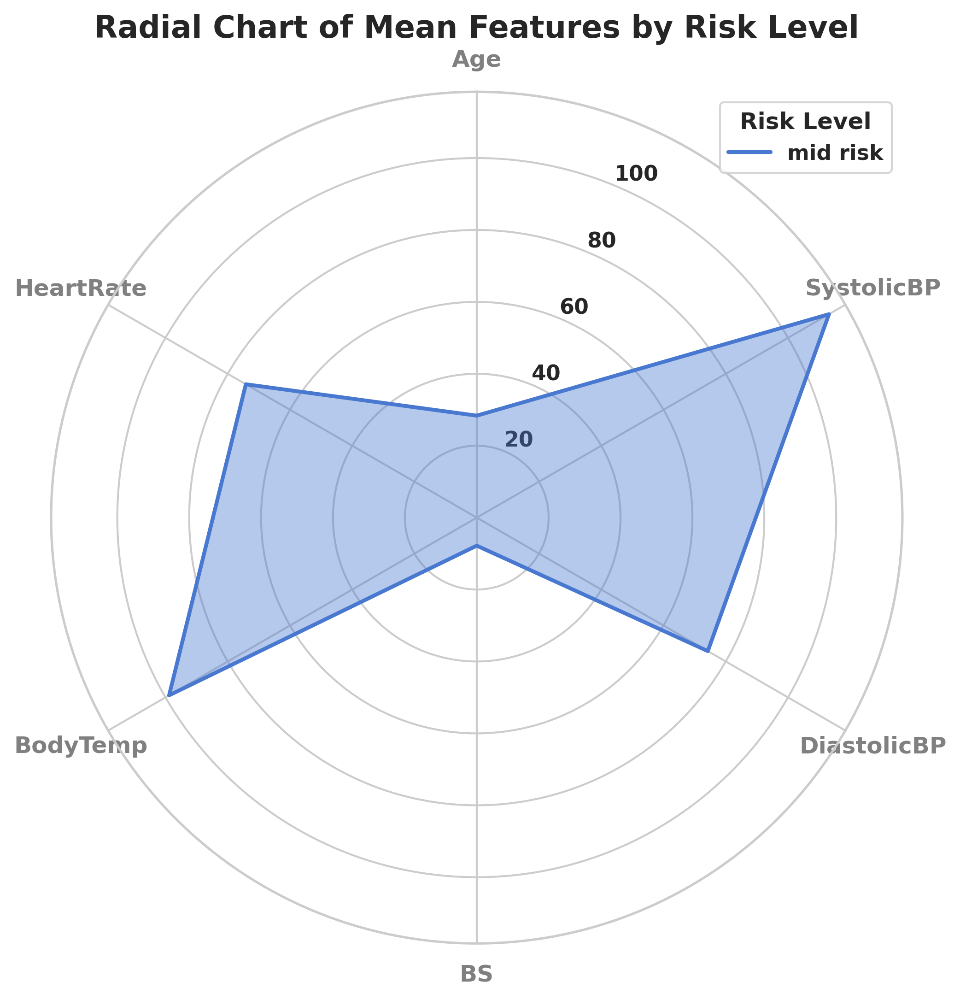

In [34]:
def create_spider_chart(data, risk_level):
    # Calculate means of numeric features
    features = data.select_dtypes(include=['int64', 'float64']).mean()
    categories = features.index.tolist()
    values = features.values.flatten().tolist()
    
    N = len(categories)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    values += values[:1]
    angles += angles[:1]

    plt.figure(figsize=(8, 8))
    ax = plt.subplot(111, polar=True)
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    plt.xticks(angles[:-1], categories, color='grey', size=12)
    ax.plot(angles, values, linewidth=2, linestyle='solid', label=risk_level)
    ax.fill(angles, values, alpha=0.4)

# Create spider charts for each risk level
plt.figure(figsize=(10, 10))
for risk_level in data['RiskLevel'].unique():
    create_spider_chart(data[data['RiskLevel'] == risk_level], risk_level)
plt.title('Radial Chart of Mean Features by Risk Level', fontsize=16, fontweight='bold')
plt.legend(title='Risk Level')
plt.show()


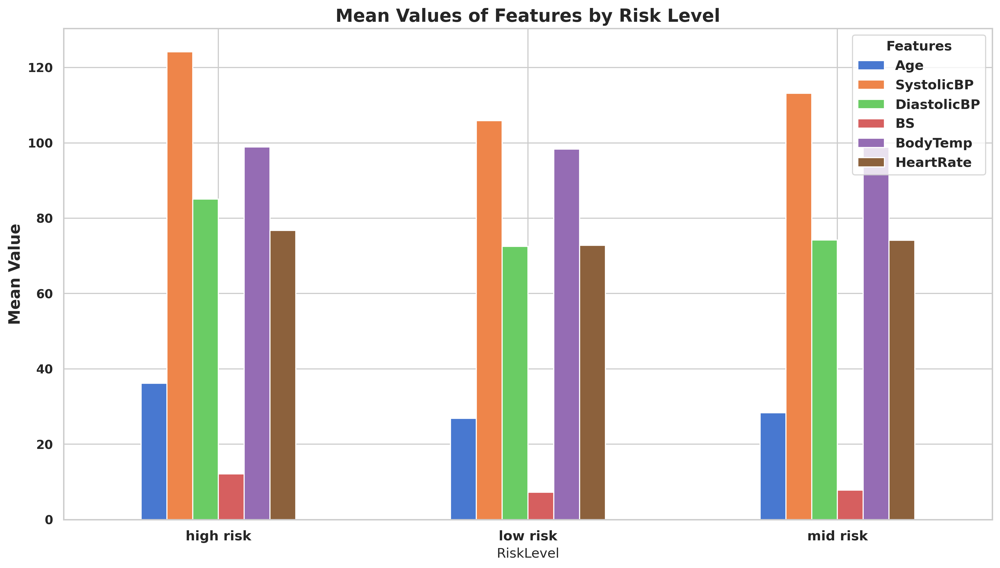

In [35]:
mean_values = data.groupby('RiskLevel').mean()
mean_values.plot(kind='bar', figsize=(15, 8))
plt.title('Mean Values of Features by Risk Level', fontsize=16, fontweight='bold')
plt.ylabel('Mean Value', fontsize=14, fontweight='bold')
plt.xticks(rotation=0, fontsize=12, fontweight='bold')
plt.legend(title='Features', fontsize=12)
plt.show()


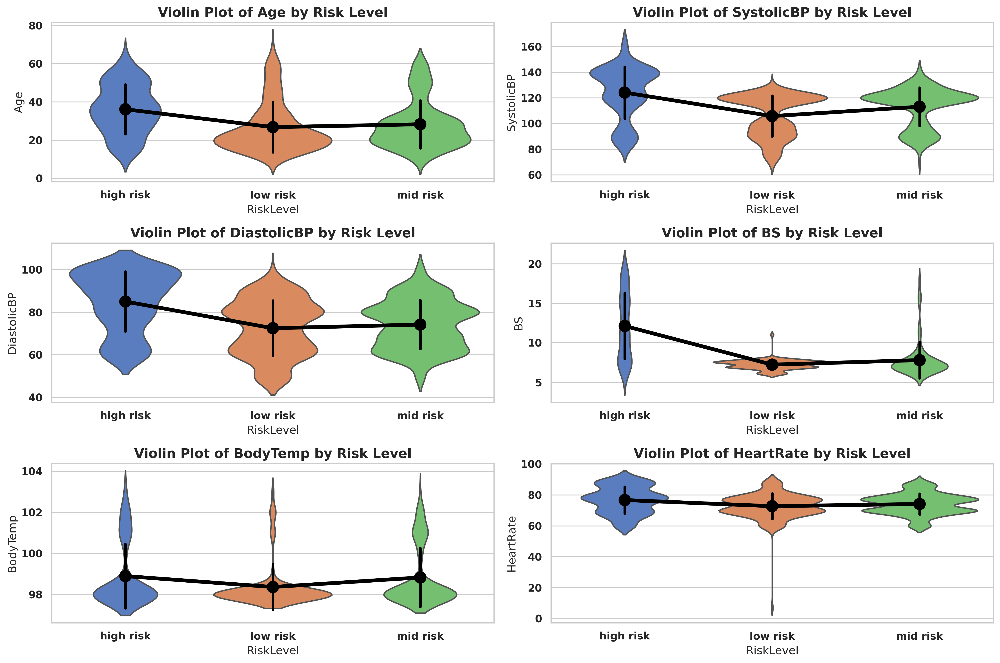

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i+1)
    sns.violinplot(x='RiskLevel', y=col, data=data, inner=None)
    sns.pointplot(x='RiskLevel', y=col, data=data, estimator=np.mean, ci='sd', color='black', markers='o', scale=1.5)
    plt.title(f'Violin Plot of {col} by Risk Level', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()


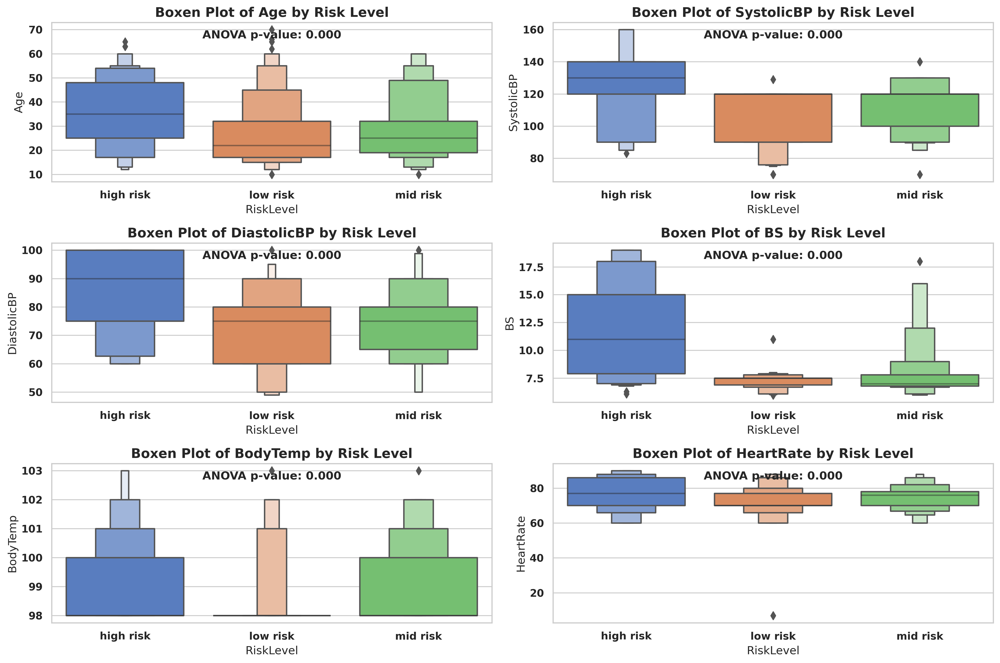

In [37]:
from scipy import stats

plt.figure(figsize=(15, 10))
for i, col in enumerate(data.select_dtypes(include=['int64', 'float64']).columns):
    plt.subplot(3, 2, i+1)
    sns.boxenplot(x='RiskLevel', y=col, data=data)
    plt.title(f'Boxen Plot of {col} by Risk Level', fontsize=14, fontweight='bold')

    # Perform statistical tests and annotate
    groups = [group[col].dropna() for name, group in data.groupby('RiskLevel')]
    stat, p = stats.f_oneway(*groups)
    plt.text(0.5, 0.9, f'ANOVA p-value: {p:.3f}', horizontalalignment='center', transform=plt.gca().transAxes, fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()


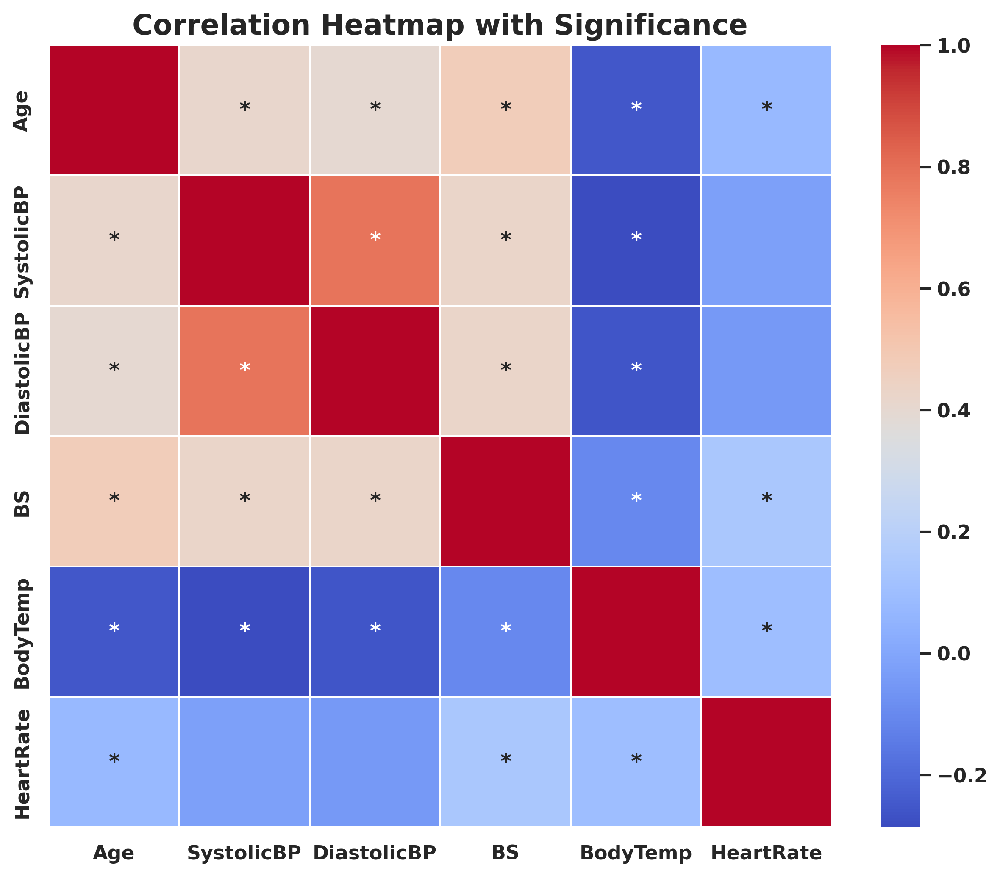

In [38]:
from scipy.stats import pearsonr
import numpy as np

def correlation_matrix(data):
    numeric_data = data.select_dtypes(include=[np.number])
    corr = numeric_data.corr()
    p_values = np.zeros(corr.shape)
    
    for i in range(len(corr.columns)):
        for j in range(len(corr.columns)):
            if i != j:  
                _, p_values[i, j] = pearsonr(numeric_data.iloc[:, i], numeric_data.iloc[:, j])
            else:
                p_values[i, j] = np.nan  

    return corr, p_values

correlation, p_values = correlation_matrix(data)

plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=np.where(p_values < 0.05, '*', ''), fmt='', cmap='coolwarm', square=True, linewidths=0.5)
plt.title('Correlation Heatmap with Significance', fontsize=16, fontweight='bold')
plt.show()


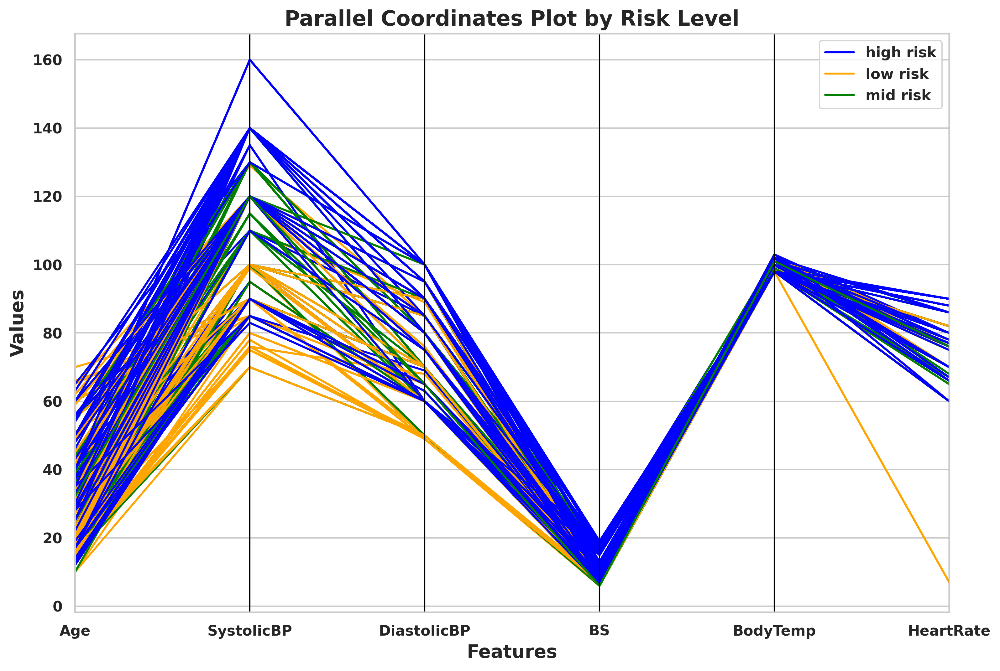

In [39]:
from pandas.plotting import parallel_coordinates

plt.figure(figsize=(12, 8))
parallel_coordinates(data, 'RiskLevel', color=['blue', 'orange', 'green'])
plt.title('Parallel Coordinates Plot by Risk Level', fontsize=16, fontweight='bold')
plt.xlabel('Features', fontsize=14, fontweight='bold')
plt.ylabel('Values', fontsize=14, fontweight='bold')
plt.grid()
plt.show()


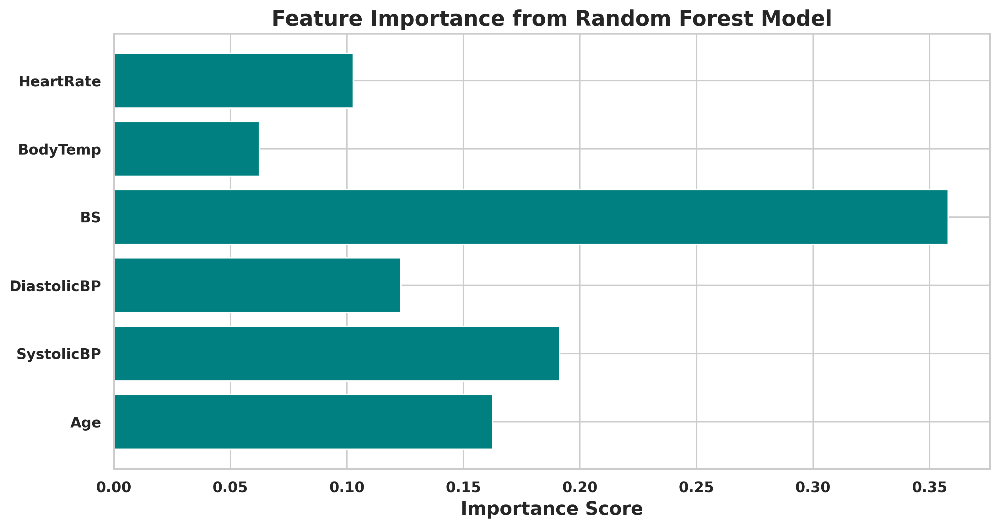

In [40]:
from sklearn.ensemble import RandomForestClassifier

X = data.drop('RiskLevel', axis=1)
y = data['RiskLevel']
model = RandomForestClassifier()
model.fit(X, y)

importances = model.feature_importances_
features = X.columns

plt.figure(figsize=(12, 6))
plt.barh(features, importances, color='teal')
plt.title('Feature Importance from Random Forest Model', fontsize=16, fontweight='bold')
plt.xlabel('Importance Score', fontsize=14, fontweight='bold')
plt.show()


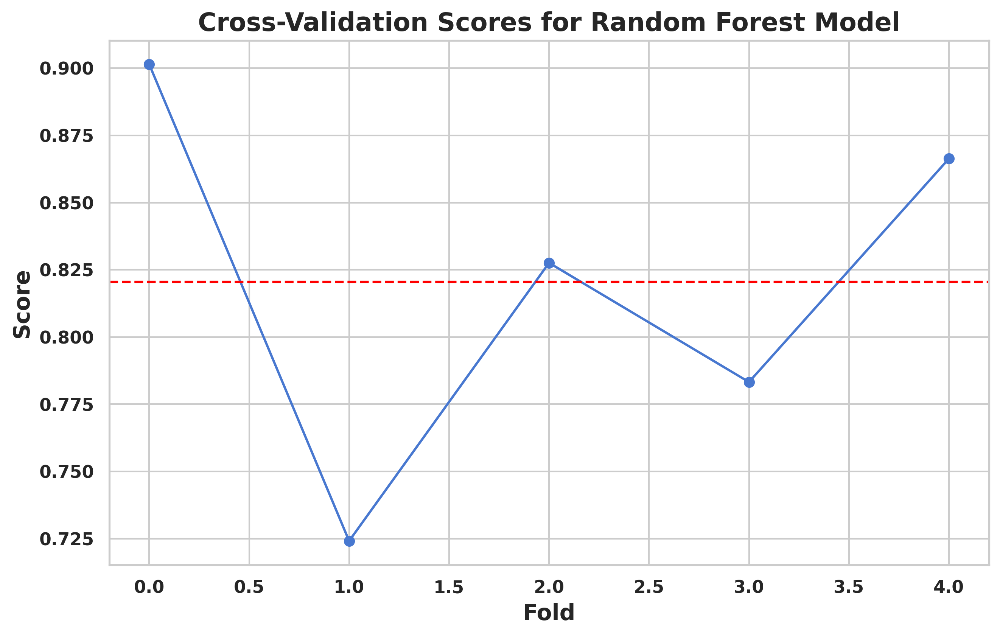

In [41]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()
cv_scores = cross_val_score(model, X, y, cv=5)

plt.figure(figsize=(10, 6))
plt.plot(cv_scores, marker='o')
plt.title('Cross-Validation Scores for Random Forest Model', fontsize=16, fontweight='bold')
plt.xlabel('Fold', fontsize=14, fontweight='bold')
plt.ylabel('Score', fontsize=14, fontweight='bold')
plt.axhline(y=cv_scores.mean(), color='red', linestyle='--')
plt.show()


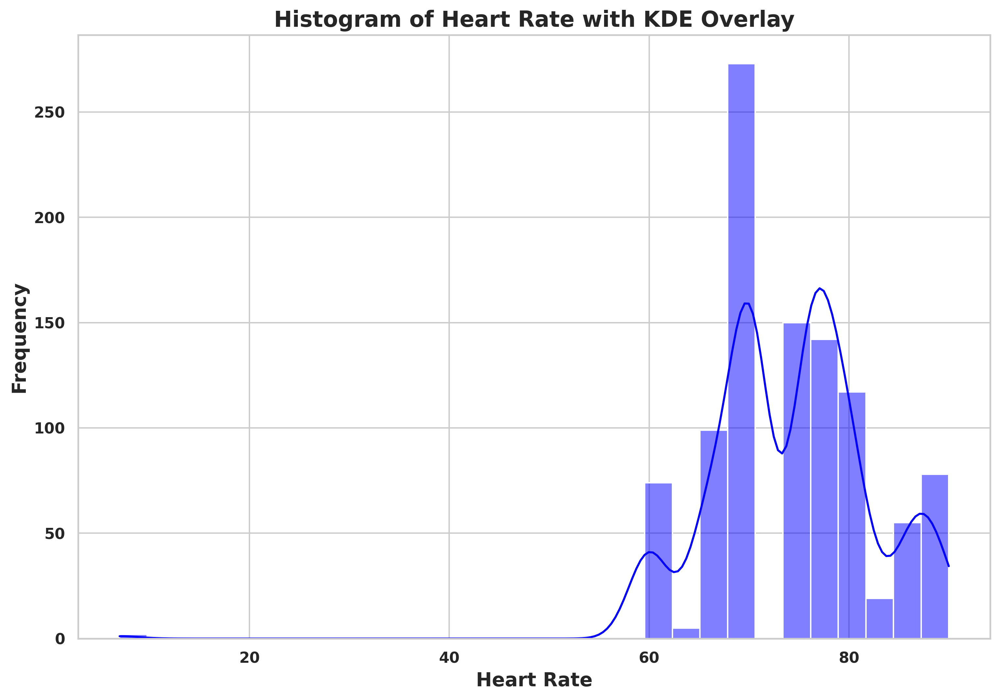

In [42]:
plt.figure(figsize=(12, 8))
sns.histplot(data['HeartRate'], kde=True, color='blue', bins=30)
plt.title('Histogram of Heart Rate with KDE Overlay', fontsize=16, fontweight='bold')
plt.xlabel('Heart Rate', fontsize=14, fontweight='bold')
plt.ylabel('Frequency', fontsize=14, fontweight='bold')
plt.show()


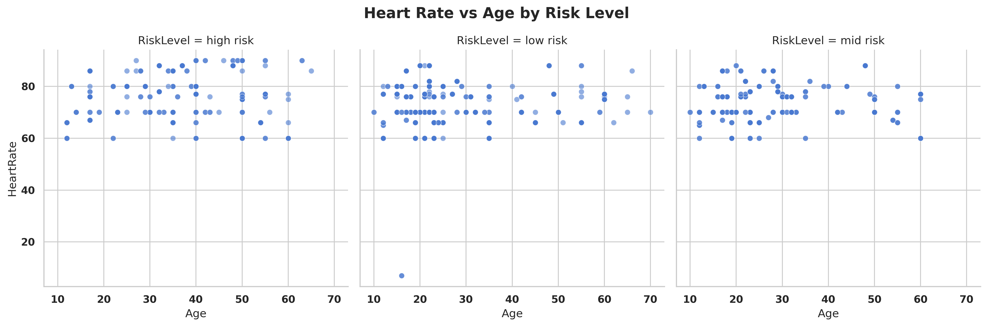

In [43]:
g = sns.FacetGrid(data, col='RiskLevel', height=5, aspect=1)
g.map(sns.scatterplot, 'Age', 'HeartRate', alpha=0.6)
g.add_legend()
g.fig.suptitle('Heart Rate vs Age by Risk Level', fontsize=16, fontweight='bold')
plt.subplots_adjust(top=0.85)
plt.show()


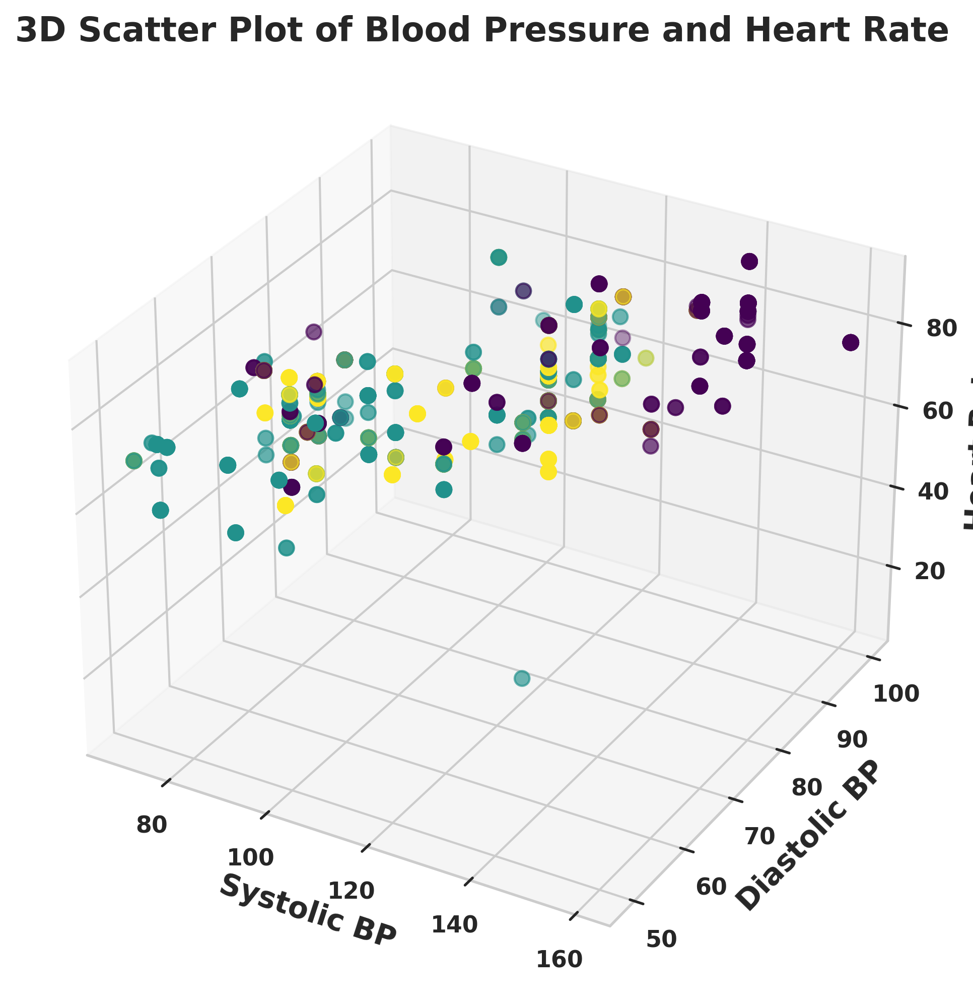

In [44]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(data['SystolicBP'], data['DiastolicBP'], data['HeartRate'], c=data['RiskLevel'].astype('category').cat.codes, cmap='viridis', s=50)
ax.set_xlabel('Systolic BP', fontsize=14, fontweight='bold')
ax.set_ylabel('Diastolic BP', fontsize=14, fontweight='bold')
ax.set_zlabel('Heart Rate', fontsize=14, fontweight='bold')
plt.title('3D Scatter Plot of Blood Pressure and Heart Rate', fontsize=16, fontweight='bold')
plt.show()


<Figure size 3600x2400 with 0 Axes>

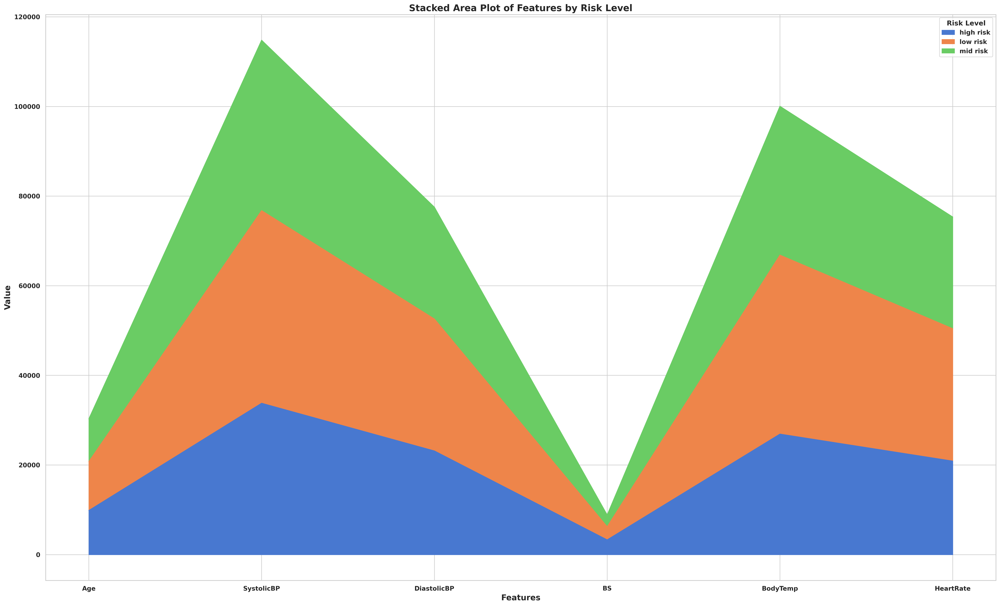

In [45]:
data_grouped = data.groupby('RiskLevel').sum().T

plt.figure(figsize=(12, 8))
data_grouped.plot.area()
plt.title('Stacked Area Plot of Features by Risk Level', fontsize=16, fontweight='bold')
plt.xlabel('Features', fontsize=14, fontweight='bold')
plt.ylabel('Value', fontsize=14, fontweight='bold')
plt.legend(title='Risk Level')
plt.show()


In [46]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=['High Risk', 'Medium Risk', 'Low Risk'],
    ),
    link=dict(
        source=[0, 1, 0, 1],  # Indices correspond to labels
        target=[1, 2, 2, 0],
        value=[8, 4, 2, 6],
    ))])

fig.update_layout(title_text="Sankey Diagram of Risk Levels", font_size=10)
fig.show()


In [47]:
data

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
0,25,130,80,15.0,98.0,86,high risk
1,35,140,90,13.0,98.0,70,high risk
2,29,90,70,8.0,100.0,80,high risk
3,30,140,85,7.0,98.0,70,high risk
4,35,120,60,6.1,98.0,76,low risk
...,...,...,...,...,...,...,...
1009,22,120,60,15.0,98.0,80,high risk
1010,55,120,90,18.0,98.0,60,high risk
1011,35,85,60,19.0,98.0,86,high risk
1012,43,120,90,18.0,98.0,70,high risk


In [48]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder

X = df.drop('RiskLevel', axis=1)
y = df['RiskLevel']

# Encoding categorical labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Scaling numerical features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_encoded, test_size=0.2, random_state=42)


In [49]:
import tensorflow as tf
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

# Build the model
model = models.Sequential()

# Input layer
model.add(layers.Input(shape=(X_train.shape[1],)))

# First hidden layer with Batch Normalization and L2 regularization
model.add(layers.Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(layers.BatchNormalization())
model.add(layers.Dropout(0.2))

# Second hidden layer
model.add(layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(layers.BatchNormalization())
model.add(layers.Dropout(0.2))

# Third hidden layer
model.add(layers.Dense(32, activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(layers.BatchNormalization())
model.add(layers.Dropout(0.2))

# Fourth hidden layer
model.add(layers.Dense(16, activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model.add(layers.BatchNormalization())

# Output layer
model.add(layers.Dense(len(label_encoder.classes_), activation='softmax'))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.keras', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)




In [50]:
history = model.fit(X_train, y_train, epochs=100, batch_size=16, 
                    validation_split=0.2, 
                    callbacks=[early_stopping, model_checkpoint, reduce_lr])

Epoch 1/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.3459 - loss: 3.2129 - val_accuracy: 0.5276 - val_loss: 2.6122 - learning_rate: 0.0010
Epoch 2/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5625 - loss: 2.4993 - val_accuracy: 0.5767 - val_loss: 2.5226 - learning_rate: 0.0010
Epoch 3/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6201 - loss: 2.4228 - val_accuracy: 0.6380 - val_loss: 2.4228 - learning_rate: 0.0010
Epoch 4/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6175 - loss: 2.3664 - val_accuracy: 0.6196 - val_loss: 2.3444 - learning_rate: 0.0010
Epoch 5/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6257 - loss: 2.2869 - val_accuracy: 0.6319 - val_loss: 2.2587 - learning_rate: 0.0010
Epoch 6/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6357 - loss: 2.1758 - val_accuracy: 0.6626 - val_loss: 2.1706 - learning_rate: 0.0010
Epoch 7/100
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6535 - loss: 2.1004 - val_ac

In [51]:
# Make predictions
predictions = model.predict(X_test)
predicted_classes = tf.argmax(predictions, axis=1)


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


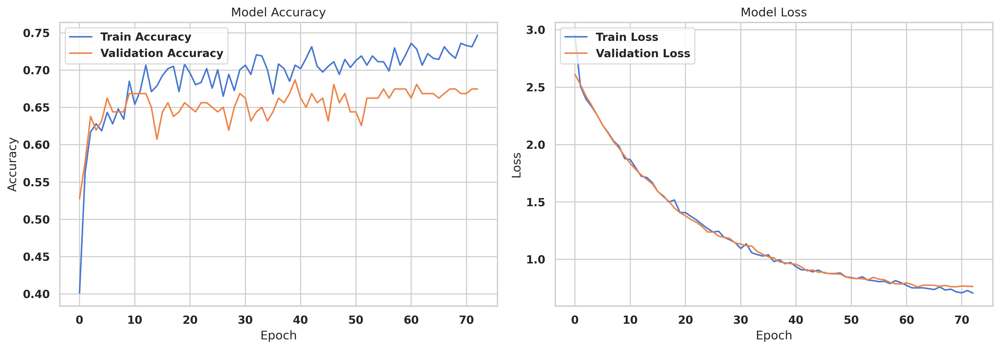

In [52]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()


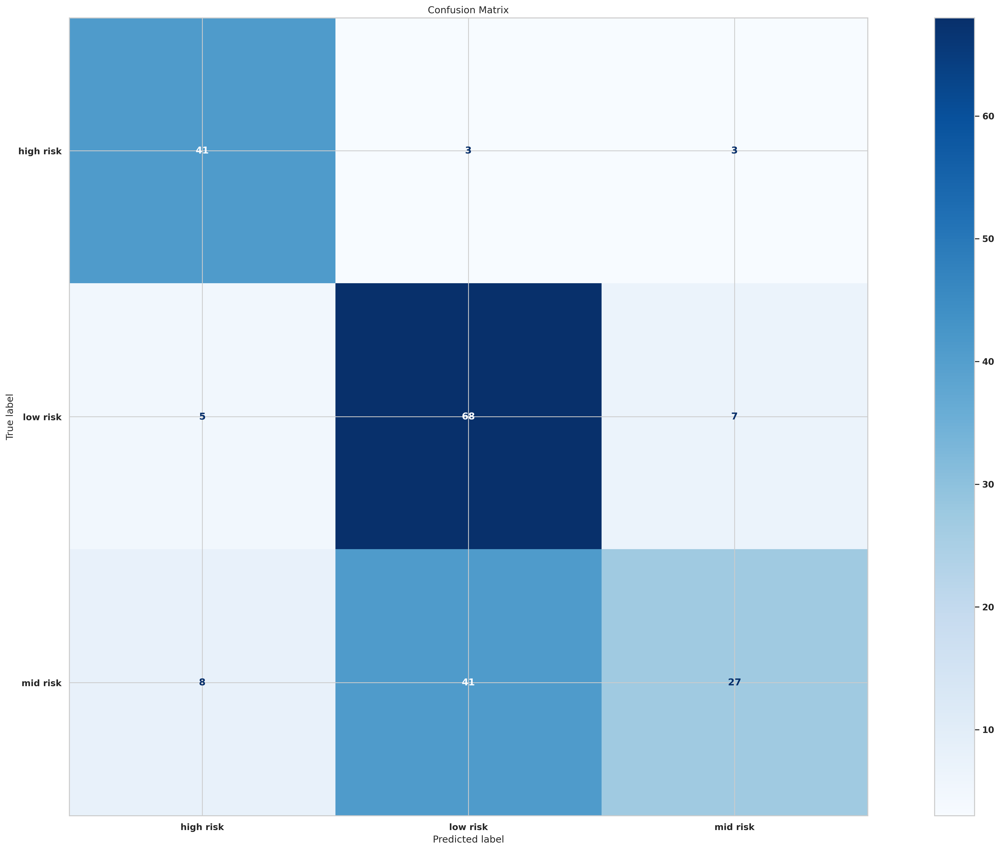

In [53]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compute confusion matrix
cm = confusion_matrix(y_test, predicted_classes)

# Display confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()


In [54]:
from sklearn.metrics import classification_report

# Print classification report
report = classification_report(y_test, predicted_classes, target_names=label_encoder.classes_)
print(report)


              precision    recall  f1-score   support

   high risk       0.76      0.87      0.81        47
    low risk       0.61      0.85      0.71        80
    mid risk       0.73      0.36      0.48        76

    accuracy                           0.67       203
   macro avg       0.70      0.69      0.67       203
weighted avg       0.69      0.67      0.65       203



7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


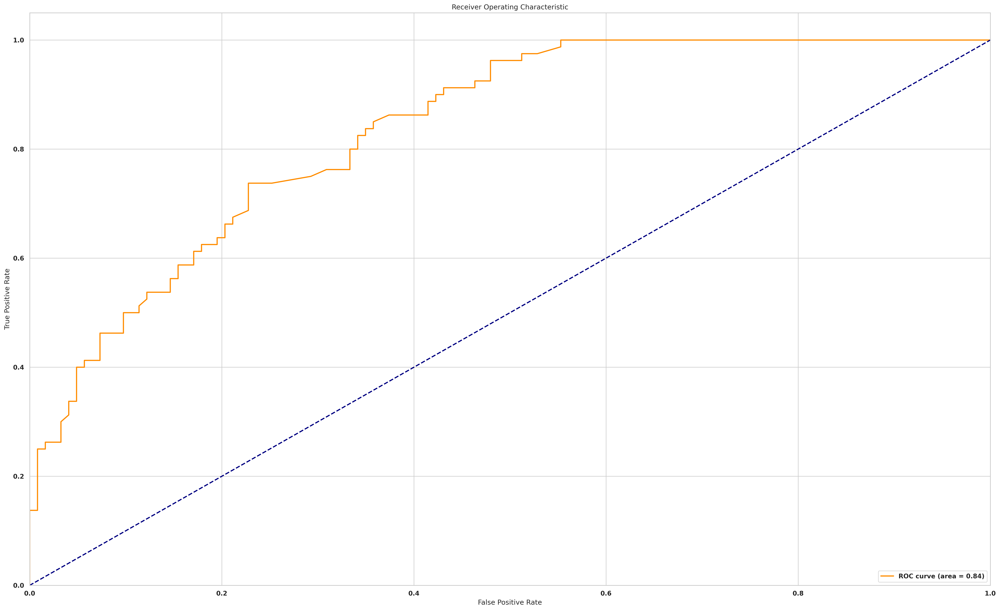

In [55]:
from sklearn.metrics import roc_curve, auc

# For binary classification (modify accordingly for multi-class)
y_test_binary = (y_test == 1).astype(int)  # Adjust based on your positive class
y_scores = model.predict(X_test)[:, 1]  # Get probabilities for the positive class

fpr, tpr, thresholds = roc_curve(y_test_binary, y_scores)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


In [56]:
X = data.drop(columns=['RiskLevel'])
y = data['RiskLevel']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [57]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import StandardScaler

In [58]:
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Make predictions
rf_predictions = rf_model.predict(X_test)

# Evaluate the model
rf_accuracy = accuracy_score(y_test, rf_predictions)
print(f'Random Forest Accuracy: {rf_accuracy:.2f}')
print(classification_report(y_test, rf_predictions))


Random Forest Accuracy: 0.81
              precision    recall  f1-score   support

   high risk       0.87      0.85      0.86        47
    low risk       0.86      0.75      0.80        80
    mid risk       0.74      0.84      0.79        76

    accuracy                           0.81       203
   macro avg       0.82      0.81      0.82       203
weighted avg       0.81      0.81      0.81       203



In [59]:
lr_model = LogisticRegression(max_iter=200)
lr_model.fit(X_train, y_train)

lr_predictions = lr_model.predict(X_test)

lr_accuracy = accuracy_score(y_test, lr_predictions)
print(f'Logistic Regression Accuracy: {lr_accuracy:.2f}')
print(classification_report(y_test, lr_predictions))


Logistic Regression Accuracy: 0.65
              precision    recall  f1-score   support

   high risk       0.70      0.85      0.77        47
    low risk       0.62      0.89      0.73        80
    mid risk       0.68      0.28      0.39        76

    accuracy                           0.65       203
   macro avg       0.67      0.67      0.63       203
weighted avg       0.66      0.65      0.61       203



In [60]:
gb_model = GradientBoostingClassifier(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)

# Make predictions
gb_predictions = gb_model.predict(X_test)

# Evaluate the model
gb_accuracy = accuracy_score(y_test, gb_predictions)
print(f'Gradient Boosting Accuracy: {gb_accuracy:.2f}')
print(classification_report(y_test, gb_predictions))


Gradient Boosting Accuracy: 0.75
              precision    recall  f1-score   support

   high risk       0.83      0.83      0.83        47
    low risk       0.73      0.76      0.74        80
    mid risk       0.72      0.68      0.70        76

    accuracy                           0.75       203
   macro avg       0.76      0.76      0.76       203
weighted avg       0.75      0.75      0.75       203



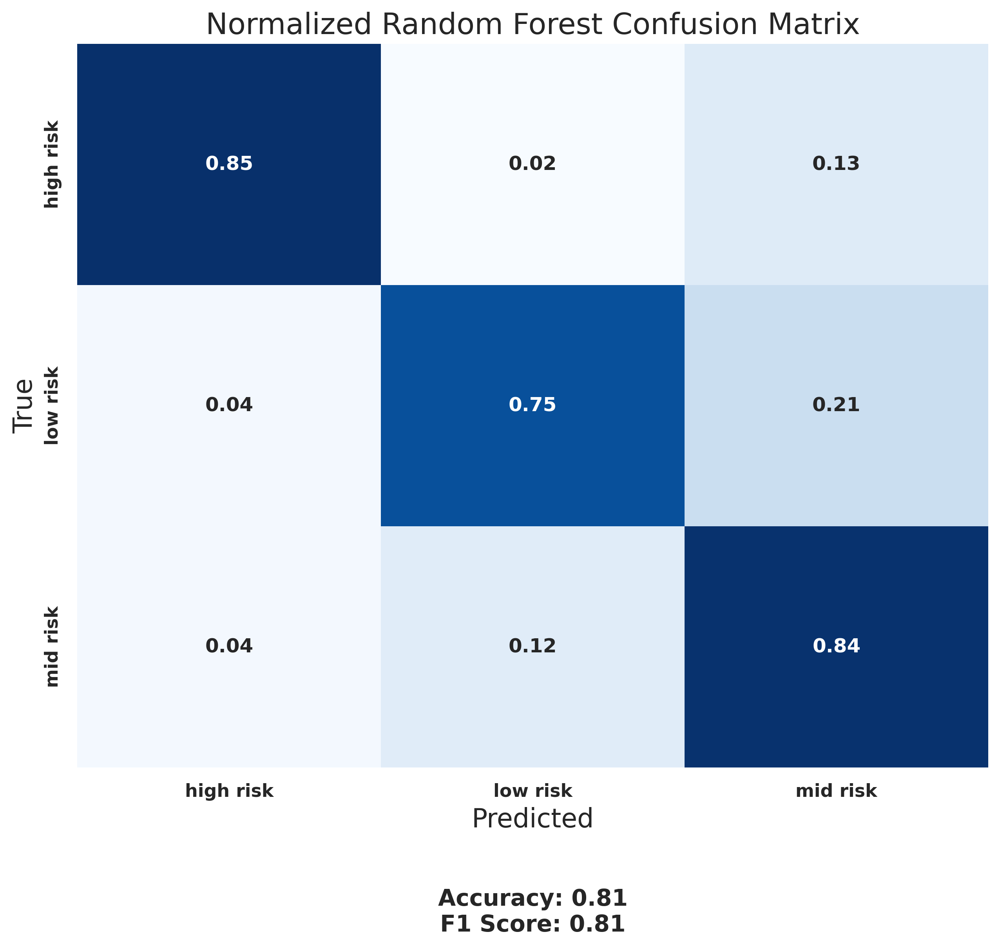

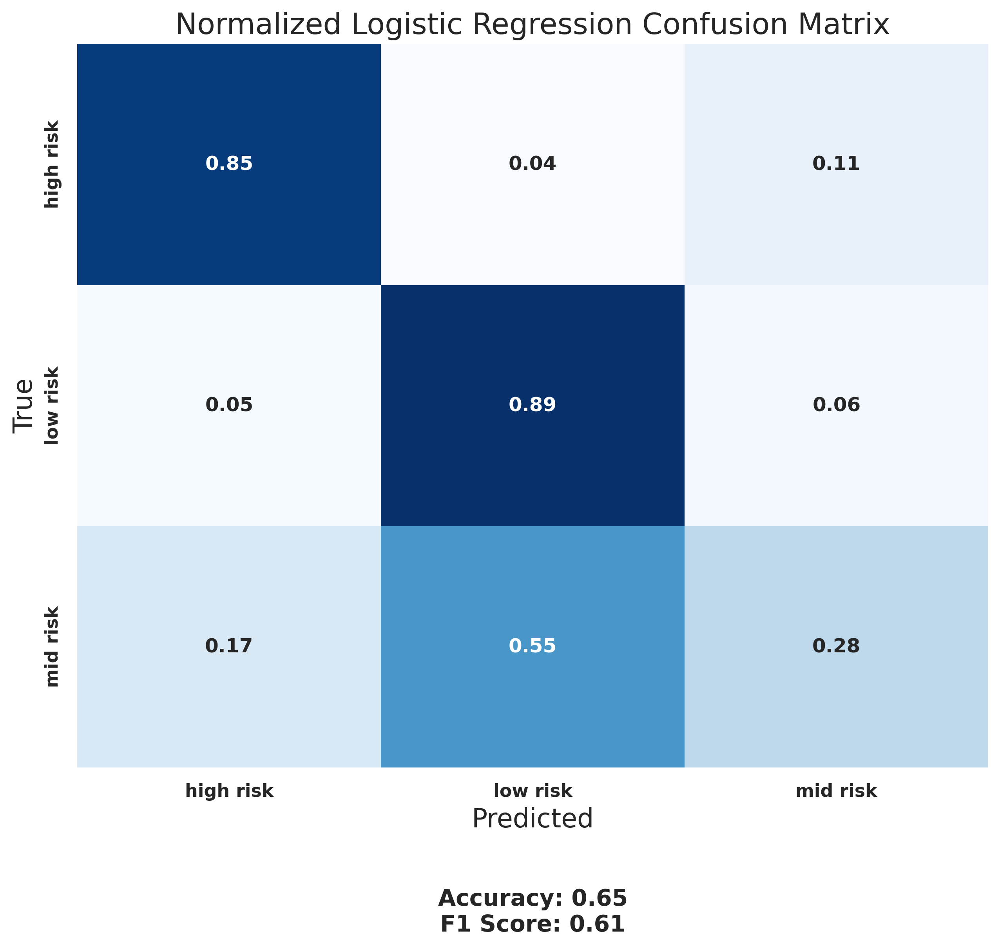

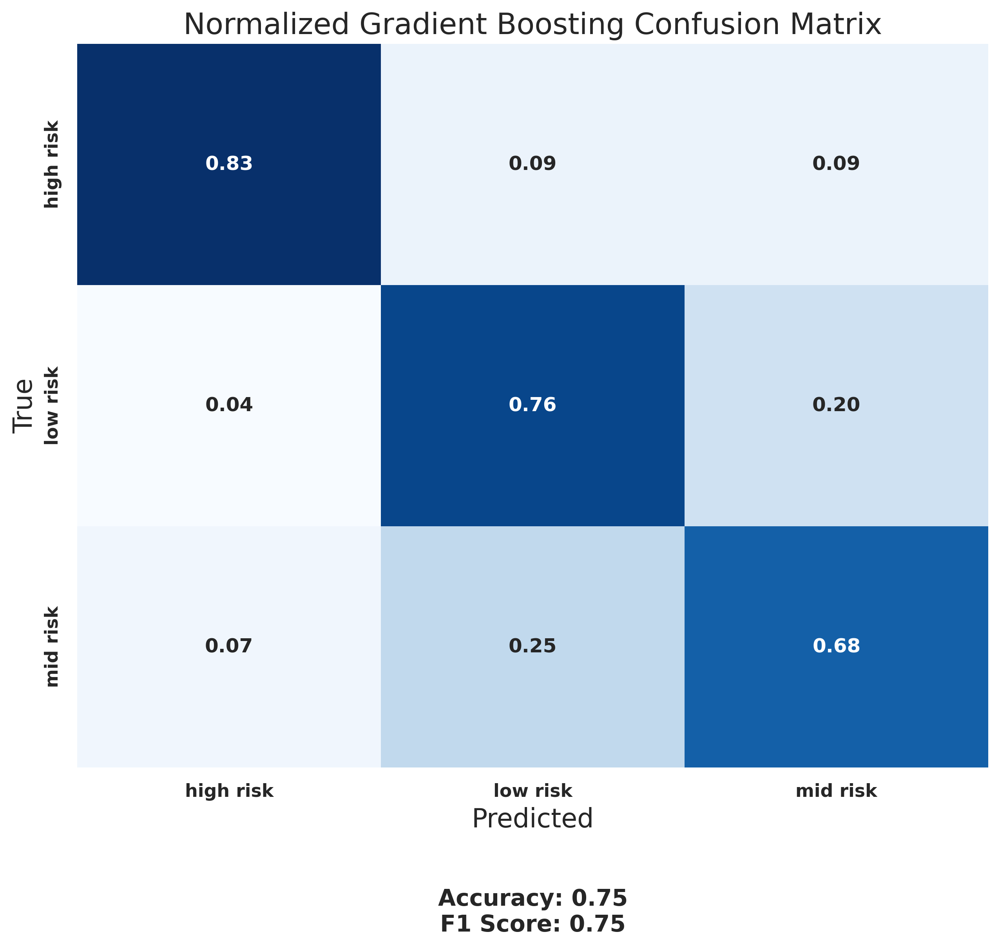

In [61]:
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score
def plot_confusion_matrix(y_true, y_pred, title='Confusion Matrix', normalize=False):
    cm = confusion_matrix(y_true, y_pred)
    
    # Normalize if specified
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        title = 'Normalized ' + title

    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='.2f' if normalize else 'd', cmap='Blues', 
                xticklabels=np.unique(y_true), yticklabels=np.unique(y_true), cbar=False)

    plt.title(title, fontsize=18)
    plt.xlabel('Predicted', fontsize=16)
    plt.ylabel('True', fontsize=16)

    # Display accuracy and F1 score
    accuracy = accuracy_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred, average='weighted')
    plt.text(0.5, -0.2, f'Accuracy: {accuracy:.2f}\nF1 Score: {f1:.2f}', 
             ha='center', va='center', fontsize=14, transform=plt.gca().transAxes)

    plt.show()

# Plot confusion matrices for each model
plot_confusion_matrix(y_test, rf_predictions, title='Random Forest Confusion Matrix', normalize=True)
plot_confusion_matrix(y_test, lr_predictions, title='Logistic Regression Confusion Matrix', normalize=True)
plot_confusion_matrix(y_test, gb_predictions, title='Gradient Boosting Confusion Matrix', normalize=True)


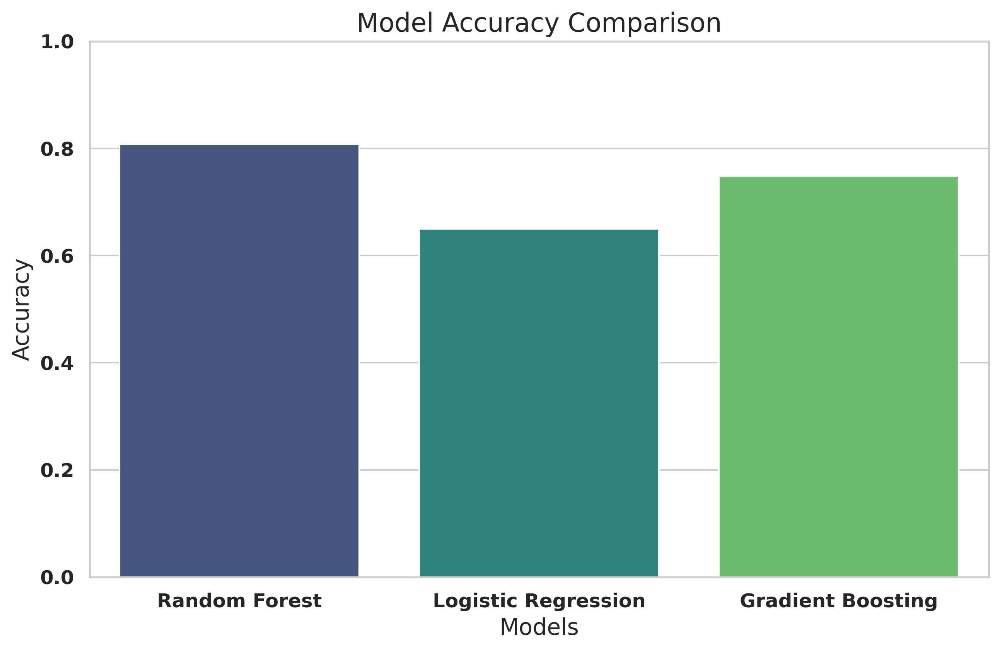

In [62]:
# Collect accuracies
model_names = ['Random Forest', 'Logistic Regression', 'Gradient Boosting']
accuracies = [rf_accuracy, lr_accuracy, gb_accuracy]

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=model_names, y=accuracies, palette='viridis')
plt.ylim(0, 1)
plt.title('Model Accuracy Comparison', fontsize=16)
plt.xlabel('Models', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()


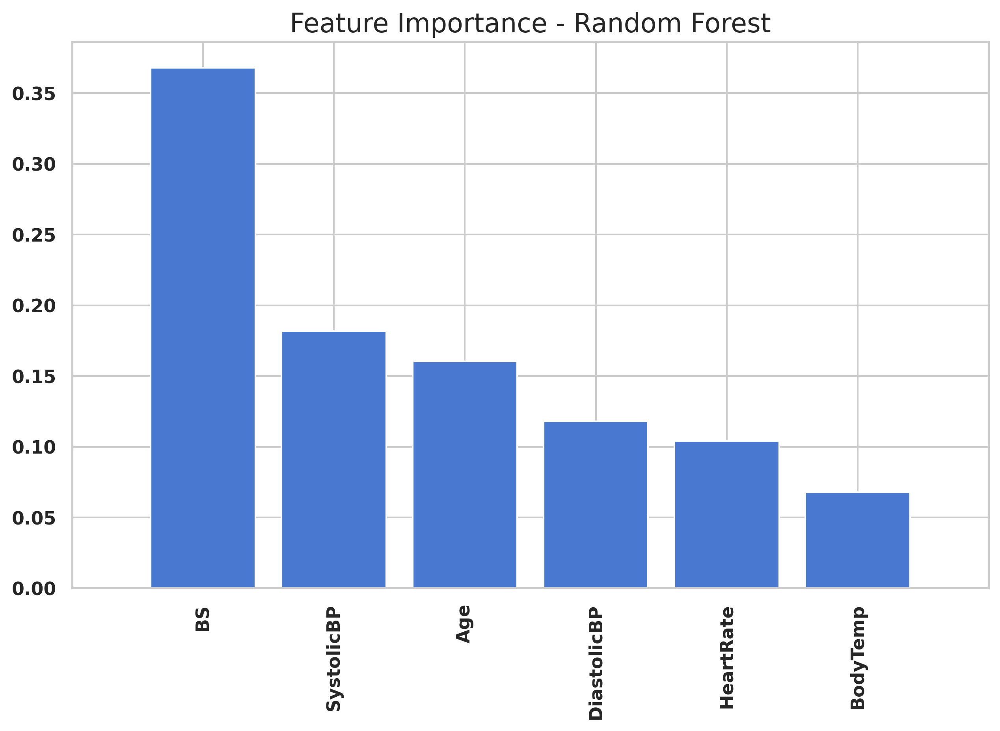

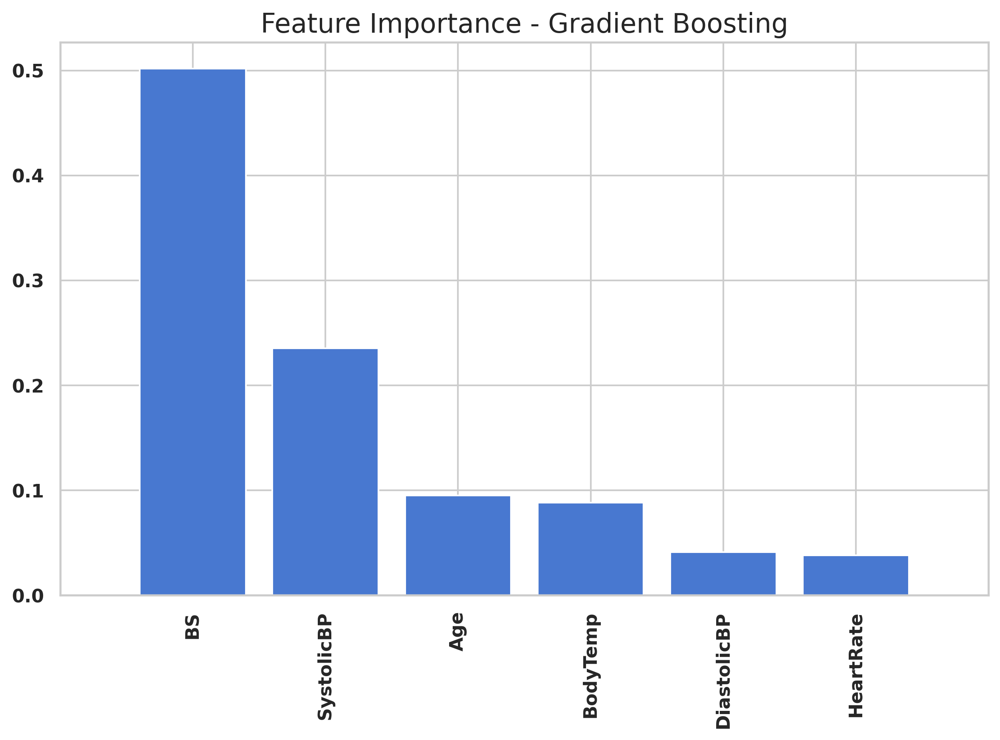

In [63]:
def plot_feature_importance(model, feature_names, model_name):
    importances = model.feature_importances_ if hasattr(model, 'feature_importances_') else None
    if importances is not None:
        indices = np.argsort(importances)[::-1]
        plt.figure(figsize=(10, 6))
        plt.title(f'Feature Importance - {model_name}', fontsize=16)
        plt.bar(range(len(importances)), importances[indices], align='center')
        plt.xticks(range(len(importances)), np.array(feature_names)[indices], rotation=90)
        plt.xlim([-1, len(importances)])
        plt.show()

plot_feature_importance(rf_model, X.columns, 'Random Forest')
plot_feature_importance(gb_model, X.columns, 'Gradient Boosting')
